# CNN Waste Classification 4: Modeling with Adjusted Learning Rate

This is a rerun of the modeling notebook for the cnn-waste-classification study, with the learning rate for Adam adjusted from the default of 0.001 to what was found, in notebook 03, to be a far more optimal learning rate of 0.0000175.  It's remarkable how much smaller this is than the default; under the default rate, many models failed to perform.  The usual outcome was a model with accuracy equal to the relative frequency of the most common category - inspection of confusion matrices revealed that these models were, indeed, simply predicting every test image to be 'Plastic' - the modal category for these data. Several more models were very slight variations on this theme; one of them switched to overpredicting 'Metal', the second most common category. 

With the (very roughly) optimized learning rate, almost every model performed far better, in terms of simple accuracy, and in many cases the confusion matrix revealed that the model was now, indeed, predicting across all categories, albeit imperfectly.


In [1]:
# imports, organized a little better

import os
import numpy as np
import pandas as pd
import tensorflow as tf
import matplotlib.image as mpimg
import matplotlib.pyplot as plt
import PIL
import pickle
import seaborn as sn
import visualkeras
import random
import gc

from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report, confusion_matrix
from sklearn.utils import class_weight
from keras import layers, Input, utils
#from keras.utils import np_utils, plot_model, to_categorical
from keras.models import Sequential, Model
from keras.layers import Dense, Conv2D, MaxPooling2D, Flatten, Dropout, BatchNormalization, GlobalAveragePooling2D
from keras.callbacks import EarlyStopping
from keras.applications import InceptionV3
from keras.applications.vgg16 import VGG16
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.utils import to_categorical
from tensorflow.keras.applications import ResNet50, DenseNet121, EfficientNetB0
from tensorflow.keras.callbacks import EarlyStopping, ReduceLROnPlateau
from IPython.display import display, Image


%matplotlib inline

2025-08-14 18:53:02.325005: I tensorflow/core/util/port.cc:113] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2025-08-14 18:53:02.353914: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2025-08-14 18:53:02.353941: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2025-08-14 18:53:02.355325: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2025-08-14 18:53:02.360616: I tensorflow/core/platform/cpu_feature_guar

In [2]:
# in this version of notebook 02, the learning rate will be set at the optimzed value found in notebook 03:  0.0000175; further interpolation may improve

NOTEBOOK_LEARNING_RATE = 0.0000175

In [3]:
# Set a consistent seed value for all stochastic processes.
SEED = 13013

np.random.seed(SEED)
tf.random.set_seed(SEED)
random.seed(SEED)

# needed for some TF ops on GPU
os.environ['TF_DETERMINISTIC_OPS'] = '1'

In [4]:
# there have been a variety of stubborn memory issues
# cuts precision in half, which should help
from tensorflow.keras.mixed_precision import set_global_policy
set_global_policy('mixed_float16')

# should help fix fragmentation issue
os.environ['TF_GPU_ALLOCATOR'] = 'cuda_malloc_async'

INFO:tensorflow:Mixed precision compatibility check (mixed_float16): OK
Your GPU will likely run quickly with dtype policy mixed_float16 as it has compute capability of at least 7.0. Your GPU: NVIDIA GeForce RTX 4060 Laptop GPU, compute capability 8.9


2025-08-14 18:53:07.649148: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2025-08-14 18:53:07.656263: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2025-08-14 18:53:07.659203: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-

In [5]:

# Get the path to the current data files
notebook_path = os.path.abspath('02-cnn-waste-classification-modeling.ipynb')
project_root = os.path.dirname(os.path.dirname(notebook_path))
load_dir = os.path.join(project_root, 'data')

# Loading .pkl files from preprocessing notebook
with open(os.path.join(load_dir, 'RealWaste_X_train_aug.pkl'), 'rb') as fh:
    X_train_aug = pickle.load(fh)

with open(os.path.join(load_dir, 'RealWaste_X_test.pkl'), 'rb') as fh:
    X_test = pickle.load(fh)

with open(os.path.join(load_dir, 'RealWaste_y_train_aug.pkl'), 'rb') as fh:
    y_train_aug = pickle.load(fh)

with open(os.path.join(load_dir, 'RealWaste_y_test.pkl'), 'rb') as fh:
    y_test = pickle.load(fh)

2025-08-14 18:53:16.577757: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2025-08-14 18:53:16.580565: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2025-08-14 18:53:16.582506: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-

In [6]:
# need these as np arrays

X_train_aug = np.asarray(X_train_aug)
X_test = np.asarray(X_test)
y_train_aug = np.asarray(y_train_aug)
y_test = np.asarray(y_test)

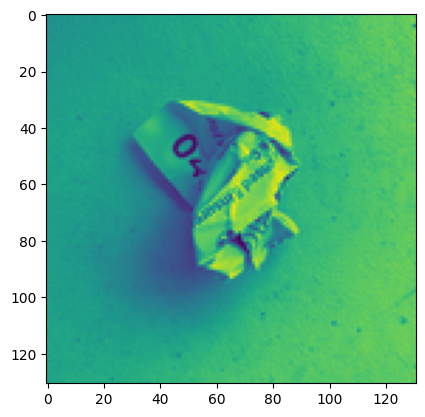

In [7]:
# verify
plt.imshow(X_train_aug[3195])

In [8]:
categories = {'Cardboard': 0,
 'Organics': 1,
 'Glass': 2,
 'Metal': 3,
 'Miscellaneous': 4,
 'Paper': 5,
 'Plastic': 6,
 'Textile Trash': 7,
 'Vegetation': 8}

In [9]:
# I might want that reversed, what's a good way to do that?

r_categories = {v: k for k, v in categories.items()}
r_categories

{0: 'Cardboard',
 1: 'Organics',
 2: 'Glass',
 3: 'Metal',
 4: 'Miscellaneous',
 5: 'Paper',
 6: 'Plastic',
 7: 'Textile Trash',
 8: 'Vegetation'}

I'm going to try to take this notebook in a more object-oriented direction, so I'm going to start by building a class to manage a CNN model, along with its training history and evaluation metrics.

In [10]:
class CNNModel:
    """
    A class to manage a CNN model, along with training history and evaluation metrics.
    """
    def __init__(self, model, model_id=""):
        self.model = model
        self.model_id = model_id
        self.history = None
        self.predictions = None
        self.confusion_matrix = None
        self.cm_df = None
        self.report = None

    def fit_model(self, train_data, validation_data, epochs=12, batch_size=32, verbose=1, **kwargs):
        self.history = self.model.fit(train_data[0], train_data[1], validation_data=validation_data, epochs=epochs, batch_size=batch_size, verbose=verbose, **kwargs)

    def predict_data(self, data_generator):
        self.predictions = np.argmax(self.model.predict(data_generator), axis=1)

    def create_confusion_matrix(self, true_labels, class_names):
        if self.predictions is not None:
            class_indices = sorted(class_names.keys())
            self.confusion_matrix = confusion_matrix(true_labels, self.predictions, labels=class_indices)
            # needed to plot using seaborn
            self.cm_df = pd.DataFrame(self.confusion_matrix, index=[class_names[i] for i in class_indices], columns=[class_names[i] for i in class_indices])
            sn.heatmap(self.cm_df, annot=True, fmt="d")
            sn.heatmap(self.cm_df, annot=True, fmt="d")
            plt.title("Confusion Matrix") # Added a title for clarity
            plt.xlabel("Predicted Label")
            plt.ylabel("True Label")
            plt.show()
            
    def get_classification_report(self, true_labels, target_names):
        if self.predictions is not None:
            self.report = classification_report(true_labels, self.predictions, target_names=target_names)
            print(self.report)
    
    def plot_training_accuracy(self):
        if self.history:
            acc = self.history.history['accuracy']
            val_acc = self.history.history['val_accuracy']
            epochs = range(1, len(acc) + 1)
            plt.plot(epochs, acc, label="Training Accuracy")
            plt.plot(epochs, val_acc, label="Validation Accuracy")
            plt.ylabel("Accuracy")
            plt.xlabel("Epochs")
            plt.xticks(epochs)
            plt.title(f"Training and Validation Accuracy - Model: {self.model_id}")
            plt.legend()
            plt.show()
            
    def get_predicted_label_distribution(self):
        if self.predictions is not None:
            predicted_series = pd.Series(self.predictions)
            return predicted_series.value_counts()
            
    def display_misclassified_examples(self, validation_data, true_labels, class_names, num_examples=5):
        """
        Randomly selects misclassified images from the validation set and displays them
        with their predicted and true labels.
        """
        if self.predictions is None:
            print("Model contains no predict values, invoke predict_data() method first.")
            return

        X_test, y_test = validation_data
        misclassified_indices = np.where(self.predictions != true_labels)[0]

        # this is never, ever going to happen
        if not misclassified_indices.size:
            print("No misclassified examples found in the validation set.")
            return

        # Invert the class_names dictionary to map indices to names
        inverted_class_names = {v: k for k, v in class_names.items()}
        num_to_show = min(num_examples, misclassified_indices.size)
        random_indices = random.sample(list(misclassified_indices), num_to_show)

        num_cols = 4
        num_rows = (num_to_show + num_cols - 1) // num_cols  # Calculate the number of rows needed

        plt.figure(figsize=(12, 3 * num_rows))  # Adjust figure height based on the number of rows
        for i, index in enumerate(random_indices):
            plt.subplot(num_rows, num_cols, i + 1)
            plt.imshow(X_test[index])
            predicted_class_index = self.predictions[index]
            true_class_index = true_labels[index]
            predicted_class_name = inverted_class_names.get(predicted_class_index, f"Unknown Pred: {predicted_class_index}")
            true_class_name = inverted_class_names.get(true_class_index, f"Unknown True: {true_class_index}")
            plt.title(f"P: {predicted_class_name}\nT: {true_class_name}")
            plt.axis('off')
        plt.tight_layout()
        plt.show()
       

After fitting a couple of models, I realized that I would also need to choose specific images given their predicted and actual labels; I used a function for this, as I'd already fit several models and adding a method to the class would require retraining all of them.

In [11]:
def display_specific_predictions(cnn_model, validation_data, true_labels, category_labels, predicted_label, actual_label, num_examples=5):
    """
    Randomly selects images from the validation set that were predicted as
    predicted_label and actually belong to actual_label
    """
    if cnn_model.predictions is None:
        print("Model has no predicted values, run predict_data() first")
        return

    X_test, y_test = validation_data
    inverted_category_labels = {v: k for k, v in category_labels.items()}

    predicted_class_index = category_labels.get(predicted_label)
    actual_class_index = category_labels.get(actual_label)

    if predicted_class_index is None or actual_class_index is None:
        print(f"Error: One or both of the specified categories not found in category_labels.")
        return

    # Find indices where the prediction matches predicted_label
    predicted_indices = np.where(cnn_model.predictions == predicted_class_index)[0]

    # Further filter for indices where the true label matches actual_label
    specific_indices = [
        idx for idx in predicted_indices if true_labels[idx] == actual_class_index
    ]

    if not specific_indices:
        print(f"No examples found where predicted '{predicted_label}' and true '{actual_label}'.")
        return

    num_to_show = min(num_examples, len(specific_indices))
    random_indices_to_show = random.sample(specific_indices, num_to_show)

    num_cols = 4
    num_rows = (num_to_show + num_cols - 1) // num_cols

    plt.figure(figsize=(12, 3 * num_rows))
    for i, index in enumerate(random_indices_to_show):
        plt.subplot(num_rows, num_cols, i + 1)
        plt.imshow(X_test[index])
        predicted_class_name = inverted_category_labels.get(cnn_model.predictions[index], f"Unknown Pred: {cnn_model.predictions[index]}")
        true_class_name = inverted_category_labels.get(true_labels[index], f"Unknown True: {true_labels[index]}")
        plt.title(f"P: {predicted_class_name}\nT: {true_class_name}")
        plt.axis('off')
    plt.tight_layout()
    plt.show()

In [12]:
# yes, having cat_labels_r is clunky and awful, I should go back and make this better 

def model_evaluation(model, test_data, cat_labels, cat_labels_r, num_imgs=10):
    model.predict_data(test_data[0])
    model.get_classification_report(test_data[1], cat_labels)
    model.plot_training_accuracy()
    model.create_confusion_matrix(test_data[1], cat_labels_r)
    model.display_misclassified_examples(test_data, test_data[1], cat_labels, num_examples=num_imgs)

In [13]:
# Get the list of all unique labels.
unique_labels = sorted(list(set(y_train_aug)))

# Convert both parameters to numpy arrays.
y_train_np = np.array(y_train_aug)
classes_np = np.array(unique_labels)

# Calculate class weights
weights = class_weight.compute_class_weight(
    class_weight='balanced',
    classes=classes_np,
    y=y_train_np
)

# Convert to a dictionary for use in the model's fit method.
class_weights = {i: weight for i, weight in enumerate(weights)}

print(class_weights)

{0: 1.1830065359477124, 1: 1.2644710578842315, 2: 1.2066666666666668, 3: 0.6693079767564712, 4: 1.0829059829059828, 5: 1.069198312236287, 6: 0.5564339042599912, 7: 1.643320363164721, 8: 1.2876016260162602}


Applying these class weights increased training time by about _sixty_ times.  I'm skeptical that they'll produce anything like a commensurate improvement in model training, so I'm abandoning them.

## Classification using CNN's "from scratch"

Before using established, standard CNN's through transfer learning, I thought I'd start with some very simple models made from scratch, in order to familiarize myself with the training procedure.

In [14]:
# starting with a very basic convolutional model


CNN_model_1 = Sequential([
    Conv2D(32,(3,3),padding='same',activation='relu',input_shape=(131,131,1)),
    MaxPooling2D(),
    Flatten(),
    Dense(256,activation='relu'),
    Dense(256,activation='relu'),
    Dropout(0.2),
    Dense(9,activation='softmax')
])

# don't really need this
#CNN_model_1.summary()

# this was actually terrible and not useful at all:
#visualkeras.layered_view(CNN_model_1, legend=True)

In [15]:
# setting learning_rate to NOTEBOOK_LEARNING_RATE
optimizer = Adam(learning_rate=NOTEBOOK_LEARNING_RATE)

CNN_model_1.compile(
    optimizer=optimizer,
    loss = 'sparse_categorical_crossentropy',
    metrics=['accuracy']
)
tf.keras.backend.clear_session()
CNN_1 = CNNModel(CNN_model_1, "basic CNN 1")

CNN_1.fit_model(train_data=(X_train_aug, y_train_aug), validation_data=(X_test, y_test), epochs=20) 


Epoch 1/20


2025-08-14 17:46:24.373065: I external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:454] Loaded cuDNN version 8906


  1/238 [..............................] - ETA: 6:09 - loss: 31.9844 - accuracy: 0.0000e+00

2025-08-14 17:46:25.331935: I external/local_xla/xla/service/service.cc:168] XLA service 0x79aa0c003620 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
2025-08-14 17:46:25.331968: I external/local_xla/xla/service/service.cc:176]   StreamExecutor device (0): NVIDIA GeForce RTX 4060 Laptop GPU, Compute Capability 8.9
2025-08-14 17:46:25.336393: I tensorflow/compiler/mlir/tensorflow/utils/dump_mlir_util.cc:269] disabling MLIR crash reproducer, set env var `MLIR_CRASH_REPRODUCER_DIRECTORY` to enable.
I0000 00:00:1755193585.385200     132 device_compiler.h:186] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the process.


238/238 [==============================] - 6s 21ms/step - loss: 5.3250 - accuracy: 0.1788 - val_loss: 2.1949 - val_accuracy: 0.1703
Epoch 2/20
238/238 [==============================] - 4s 19ms/step - loss: 2.1930 - accuracy: 0.2001 - val_loss: 2.1928 - val_accuracy: 0.1703
Epoch 3/20
238/238 [==============================] - 4s 19ms/step - loss: 2.1901 - accuracy: 0.2003 - val_loss: 2.1900 - val_accuracy: 0.1703
Epoch 4/20
238/238 [==============================] - 5s 19ms/step - loss: 2.1871 - accuracy: 0.1996 - val_loss: 2.1874 - val_accuracy: 0.1703
Epoch 5/20
238/238 [==============================] - 4s 19ms/step - loss: 2.1843 - accuracy: 0.1992 - val_loss: 2.1853 - val_accuracy: 0.1703
Epoch 6/20
238/238 [==============================] - 5s 19ms/step - loss: 2.1815 - accuracy: 0.1989 - val_loss: 2.1832 - val_accuracy: 0.1703
Epoch 7/20
238/238 [==============================] - 4s 19ms/step - loss: 2.1792 - accuracy: 0.1986 - val_loss: 2.1816 - val_accuracy: 0.1703
Epoch 8/20

30/30 [==============================] - 0s 2ms/step
               precision    recall  f1-score   support

    Cardboard       0.00      0.00      0.00       104
     Organics       0.00      0.00      0.00        77
        Glass       0.00      0.00      0.00        70
        Metal       0.00      0.00      0.00       159
Miscellaneous       0.00      0.00      0.00       105
        Paper       0.00      0.00      0.00       105
      Plastic       0.17      1.00      0.29       162
Textile Trash       0.00      0.00      0.00        61
   Vegetation       0.00      0.00      0.00       108

     accuracy                           0.17       951
    macro avg       0.02      0.11      0.03       951
 weighted avg       0.03      0.17      0.05       951



/home/appuser/.local/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1731: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", result.shape[0])
/home/appuser/.local/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1731: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", result.shape[0])
/home/appuser/.local/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1731: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", result.shape[0])


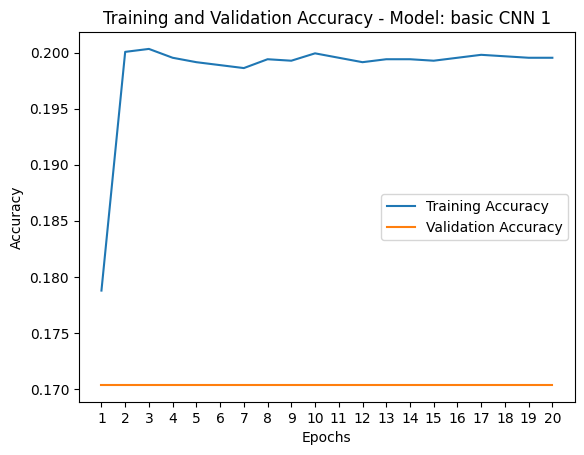

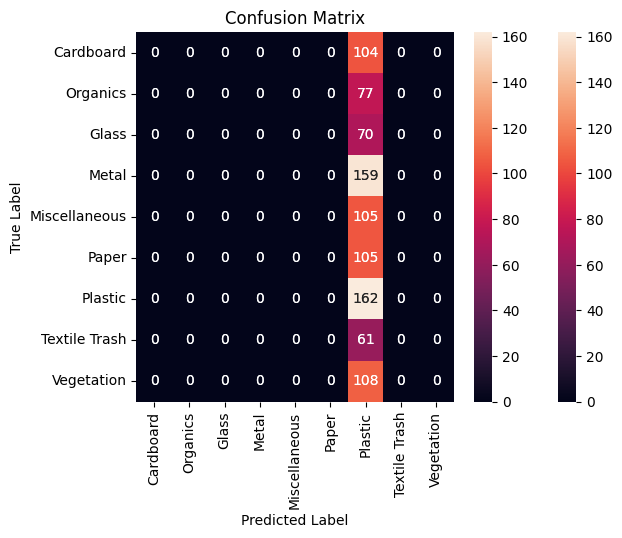

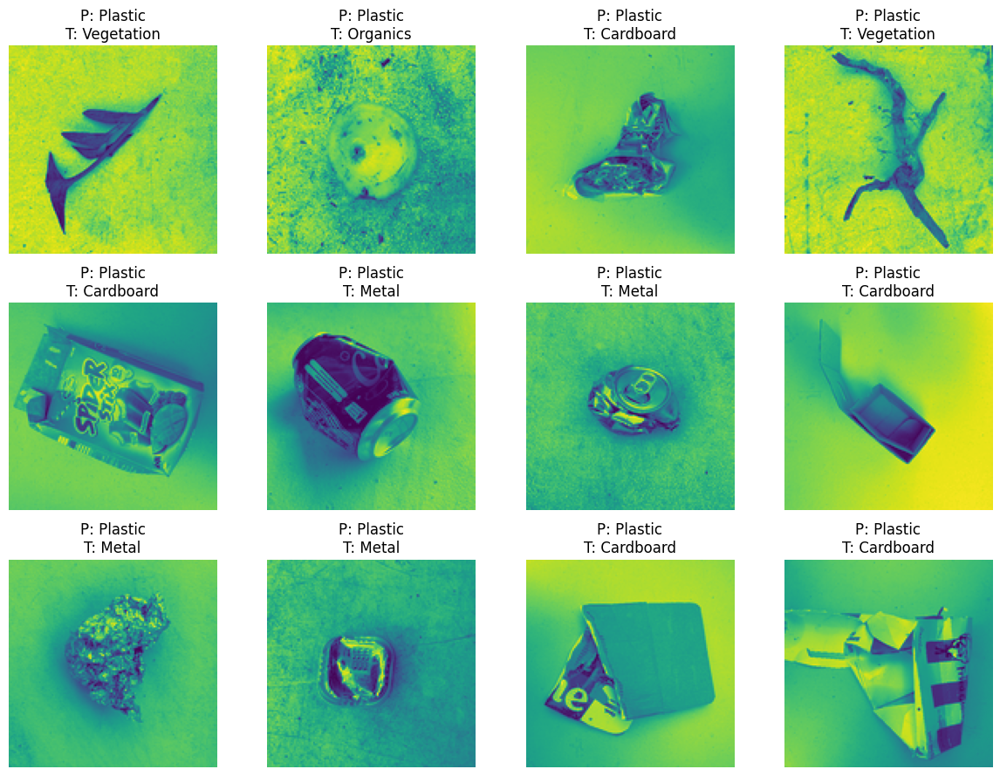

In [16]:
model_evaluation(CNN_1, (X_test, y_test), categories, r_categories, 12)

Even at this (perhaps) improved learning rate, the first CNN fails to learn anything beyond "more things are plastic than anything else"...

In [17]:
# a second model, barely more extensive

CNN_model_2 = Sequential([
    Conv2D(32,(3,3),padding='same',activation='relu',input_shape=(131,131,1)),
    MaxPooling2D(),
    Flatten(),
    Dense(256,activation='relu'),
    Dense(512,activation='relu'),
    Dense(256,activation='relu'),
    Dropout(0.2),
    Dense(9,activation='softmax')
])

#CNN_model_2.summary()

In [20]:
CNN_model_2.compile(
    optimizer=Adam(learning_rate=0.0000175),
    loss = 'sparse_categorical_crossentropy',
    metrics=['accuracy']
)

# this proved a needed insertion
tf.keras.backend.clear_session()

CNN_2 = CNNModel(CNN_model_2, "basic CNN 2")
CNN_2.fit_model(train_data=(X_train_aug, y_train_aug), validation_data=(X_test, y_test), epochs=20)

Epoch 1/20
238/238 [==============================] - 6s 22ms/step - loss: 3.4722 - accuracy: 0.1700 - val_loss: 2.1880 - val_accuracy: 0.1872
Epoch 2/20
238/238 [==============================] - 5s 20ms/step - loss: 2.1902 - accuracy: 0.2010 - val_loss: 2.1892 - val_accuracy: 0.1725
Epoch 3/20
238/238 [==============================] - 4s 18ms/step - loss: 2.1852 - accuracy: 0.2005 - val_loss: 2.1860 - val_accuracy: 0.1714
Epoch 4/20
238/238 [==============================] - 4s 18ms/step - loss: 2.1792 - accuracy: 0.2028 - val_loss: 2.1502 - val_accuracy: 0.2166
Epoch 5/20
238/238 [==============================] - 4s 18ms/step - loss: 2.1740 - accuracy: 0.2022 - val_loss: 2.1789 - val_accuracy: 0.1703
Epoch 6/20
238/238 [==============================] - 4s 18ms/step - loss: 2.1722 - accuracy: 0.1997 - val_loss: 2.1756 - val_accuracy: 0.1703
Epoch 7/20
238/238 [==============================] - 4s 17ms/step - loss: 2.1676 - accuracy: 0.1997 - val_loss: 2.1732 - val_accuracy: 0.1703

30/30 [==============================] - 0s 2ms/step
               precision    recall  f1-score   support

    Cardboard       0.00      0.00      0.00       104
     Organics       0.00      0.00      0.00        77
        Glass       0.00      0.00      0.00        70
        Metal       0.00      0.00      0.00       159
Miscellaneous       0.00      0.00      0.00       105
        Paper       0.00      0.00      0.00       105
      Plastic       0.17      1.00      0.29       162
Textile Trash       0.00      0.00      0.00        61
   Vegetation       0.00      0.00      0.00       108

     accuracy                           0.17       951
    macro avg       0.02      0.11      0.03       951
 weighted avg       0.03      0.17      0.05       951



/home/appuser/.local/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1731: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", result.shape[0])
/home/appuser/.local/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1731: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", result.shape[0])
/home/appuser/.local/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1731: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", result.shape[0])


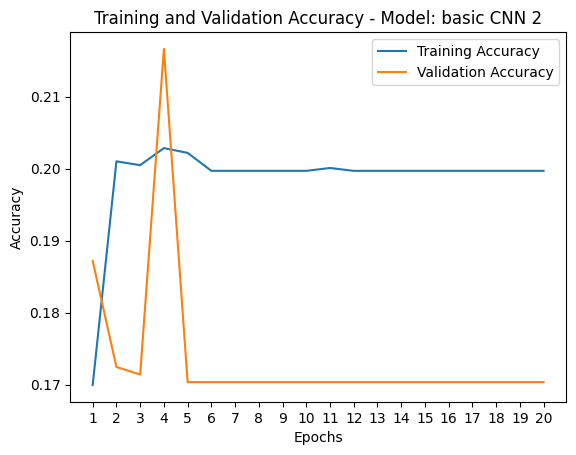

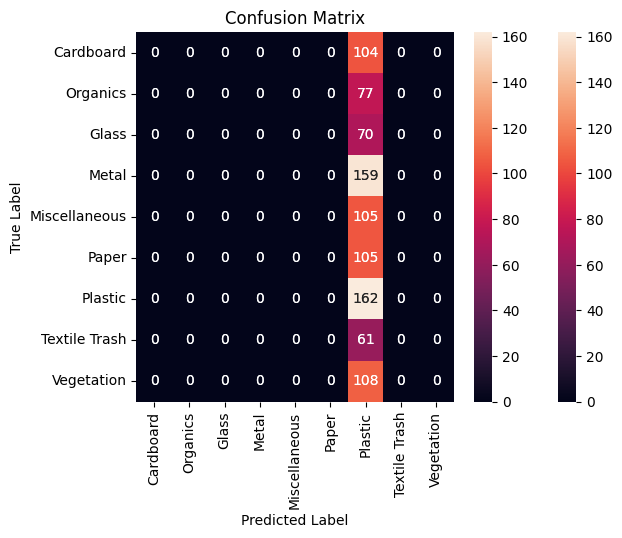

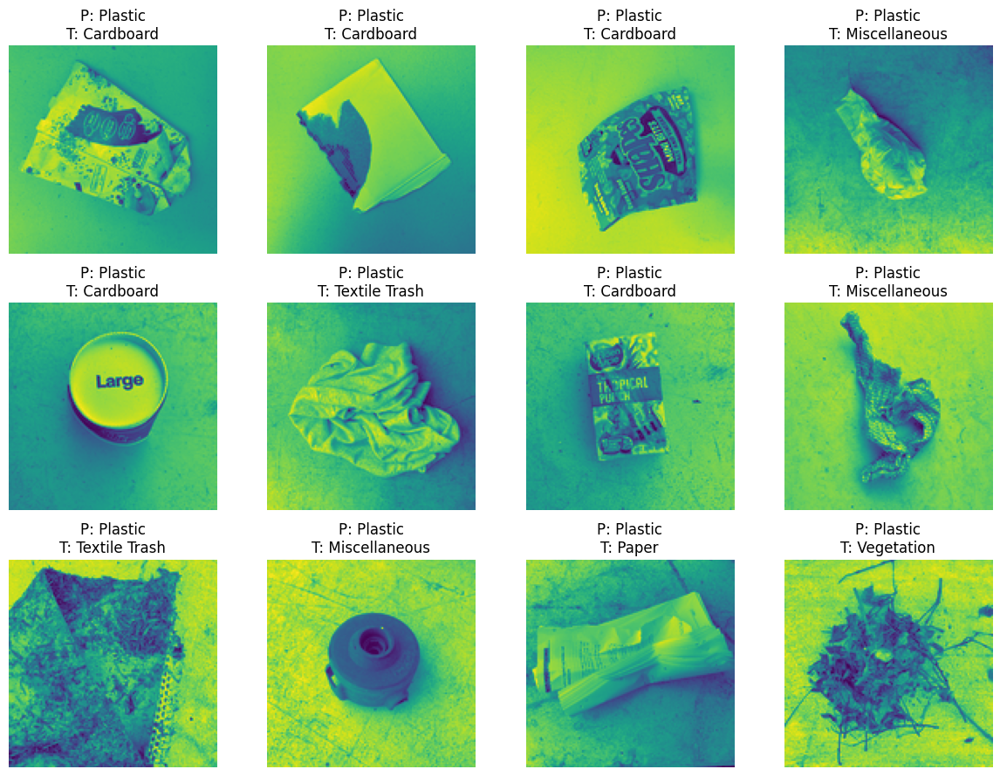

In [21]:
model_evaluation(CNN_2, (X_test, y_test), categories, r_categories, 12)

The early spike in validation accuracy isn't observed at the default learning rate; still, this model fails here too.

In [22]:
CNN_model_3 = Sequential([
    Conv2D(64,(3,3),padding='same',activation='relu',input_shape=(131,131,1)),
    MaxPooling2D(),
    Conv2D(32,(3,3),padding='same',activation='relu'),
    MaxPooling2D(),
    Flatten(),
    Dense(1024,activation='relu'),
    Dense(1024,activation='relu'),
    Dense(512,activation='relu'),
    Dense(512,activation='relu'),
    Dropout(0.2),
    Dense(9,activation='softmax')
])

#CNN_model_3.summary()

In [24]:
CNN_model_3.compile(
    optimizer=Adam(learning_rate=0.0000175),
    loss = 'sparse_categorical_crossentropy',
    metrics=['accuracy']
)

tf.keras.backend.clear_session()


CNN_3 = CNNModel(CNN_model_3, "basic CNN 3")
CNN_3.fit_model(train_data=(X_train_aug, y_train_aug), validation_data=(X_test, y_test), epochs=20)

Epoch 1/20
238/238 [==============================] - 7s 25ms/step - loss: 2.9510 - accuracy: 0.1842 - val_loss: 1.9397 - val_accuracy: 0.3165
Epoch 2/20
238/238 [==============================] - 5s 23ms/step - loss: 2.0760 - accuracy: 0.2727 - val_loss: 1.7711 - val_accuracy: 0.3460
Epoch 3/20
238/238 [==============================] - 5s 23ms/step - loss: 1.9542 - accuracy: 0.3031 - val_loss: 1.7248 - val_accuracy: 0.4017
Epoch 4/20
238/238 [==============================] - 5s 23ms/step - loss: 1.8852 - accuracy: 0.3231 - val_loss: 1.6248 - val_accuracy: 0.4017
Epoch 5/20
238/238 [==============================] - 5s 23ms/step - loss: 1.8127 - accuracy: 0.3510 - val_loss: 1.5861 - val_accuracy: 0.4469
Epoch 6/20
238/238 [==============================] - 5s 23ms/step - loss: 1.7346 - accuracy: 0.3740 - val_loss: 1.5454 - val_accuracy: 0.4574
Epoch 7/20
238/238 [==============================] - 5s 23ms/step - loss: 1.6637 - accuracy: 0.4088 - val_loss: 1.5320 - val_accuracy: 0.4564

30/30 [==============================] - 0s 3ms/step
               precision    recall  f1-score   support

    Cardboard       0.58      0.35      0.43       104
     Organics       0.53      0.51      0.52        77
        Glass       0.66      0.59      0.62        70
        Metal       0.54      0.65      0.59       159
Miscellaneous       0.34      0.30      0.32       105
        Paper       0.40      0.54      0.46       105
      Plastic       0.54      0.57      0.56       162
Textile Trash       0.32      0.28      0.30        61
   Vegetation       0.68      0.68      0.68       108

     accuracy                           0.51       951
    macro avg       0.51      0.49      0.50       951
 weighted avg       0.52      0.51      0.51       951



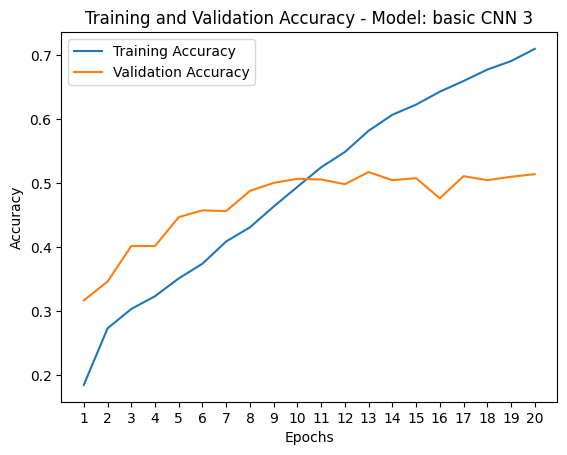

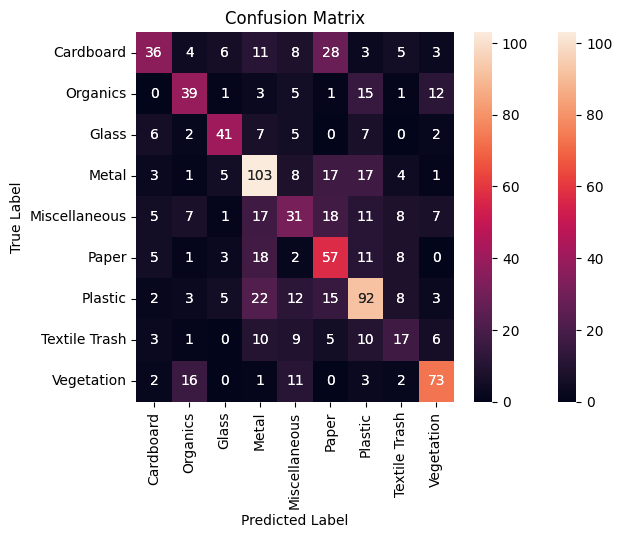

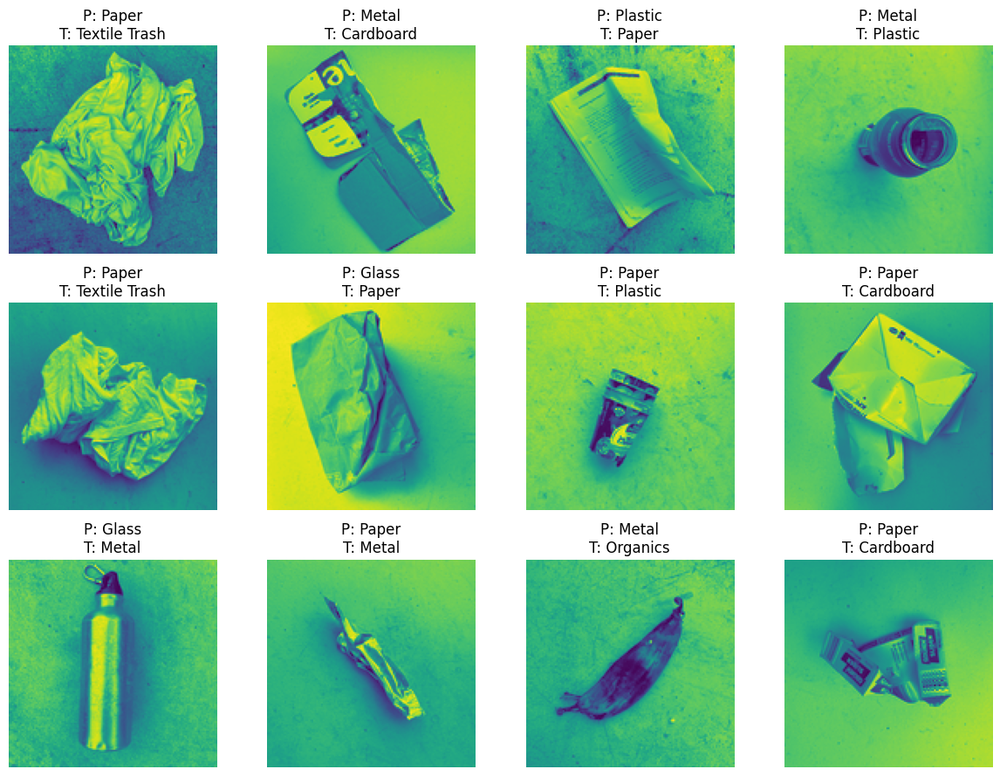

In [25]:
model_evaluation(CNN_3, (X_test, y_test), categories, r_categories, 12)

This _substantially_ outperforms the same model fit at the default 0.001 learning rate, which achieved accuracy of only 0.21.   

In [26]:
CNN_model_4 = Sequential([
    Conv2D(128,(3,3),padding='same',activation='relu',input_shape=(131,131,1)),
    MaxPooling2D(),
    Conv2D(64,(3,3),padding='same',activation='relu'),
    MaxPooling2D(),
    Conv2D(64,(3,3),padding='same',activation='relu'),
    MaxPooling2D(),
    Flatten(),
    Dense(512,activation='relu'),
    Dense(256,activation='relu'),
    Dense(512,activation='relu'),
    Dropout(0.2),
    Dense(256,activation='relu'),
    Dropout(0.2),
    Dense(9,activation='softmax')
])

#CNN_model_4.summary()

In [27]:
CNN_model_4.compile(
    optimizer=Adam(learning_rate=0.0000175),
    loss = 'sparse_categorical_crossentropy',
    metrics=['accuracy']
)

tf.keras.backend.clear_session()


CNN_4 = CNNModel(CNN_model_4, "basic CNN 4")
CNN_4.fit_model(train_data=(X_train_aug, y_train_aug), validation_data=(X_test, y_test), epochs=20)

Epoch 1/20
238/238 [==============================] - 8s 28ms/step - loss: 2.2901 - accuracy: 0.1926 - val_loss: 1.9376 - val_accuracy: 0.2976
Epoch 2/20
238/238 [==============================] - 6s 25ms/step - loss: 2.0642 - accuracy: 0.2537 - val_loss: 1.7513 - val_accuracy: 0.3975
Epoch 3/20
238/238 [==============================] - 6s 26ms/step - loss: 1.9818 - accuracy: 0.2940 - val_loss: 1.6665 - val_accuracy: 0.4217
Epoch 4/20
238/238 [==============================] - 6s 25ms/step - loss: 1.9132 - accuracy: 0.3150 - val_loss: 1.5989 - val_accuracy: 0.4164
Epoch 5/20
238/238 [==============================] - 6s 25ms/step - loss: 1.8623 - accuracy: 0.3368 - val_loss: 1.5135 - val_accuracy: 0.4711
Epoch 6/20
238/238 [==============================] - 6s 25ms/step - loss: 1.8324 - accuracy: 0.3471 - val_loss: 1.5916 - val_accuracy: 0.4217
Epoch 7/20
238/238 [==============================] - 6s 27ms/step - loss: 1.7801 - accuracy: 0.3644 - val_loss: 1.4503 - val_accuracy: 0.5047

30/30 [==============================] - 0s 3ms/step
               precision    recall  f1-score   support

    Cardboard       0.63      0.50      0.56       104
     Organics       0.52      0.65      0.57        77
        Glass       0.65      0.51      0.58        70
        Metal       0.52      0.84      0.64       159
Miscellaneous       0.53      0.25      0.34       105
        Paper       0.52      0.34      0.41       105
      Plastic       0.53      0.61      0.57       162
Textile Trash       0.30      0.21      0.25        61
   Vegetation       0.73      0.75      0.74       108

     accuracy                           0.55       951
    macro avg       0.55      0.52      0.52       951
 weighted avg       0.55      0.55      0.54       951



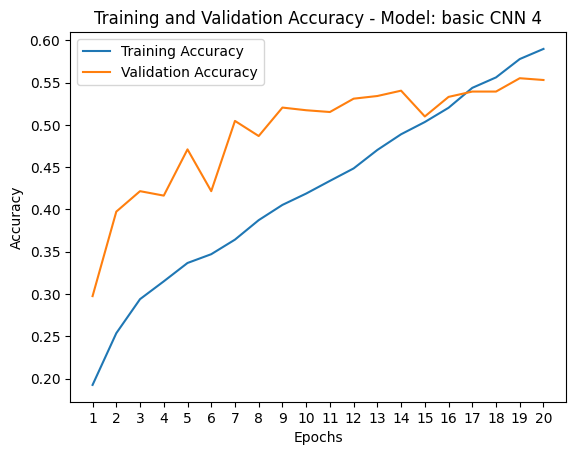

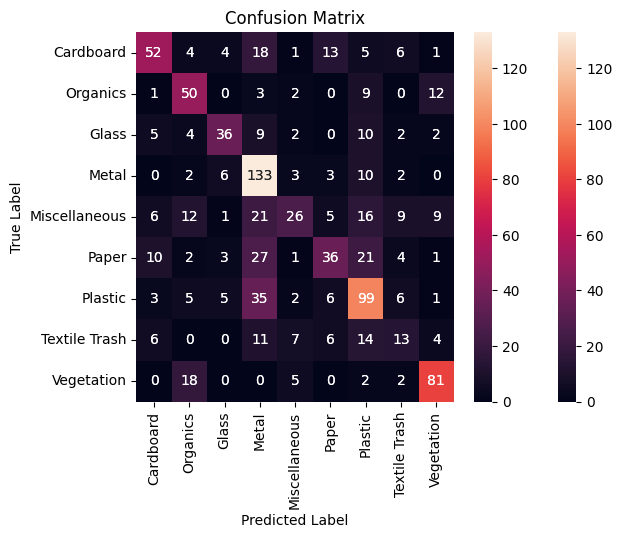

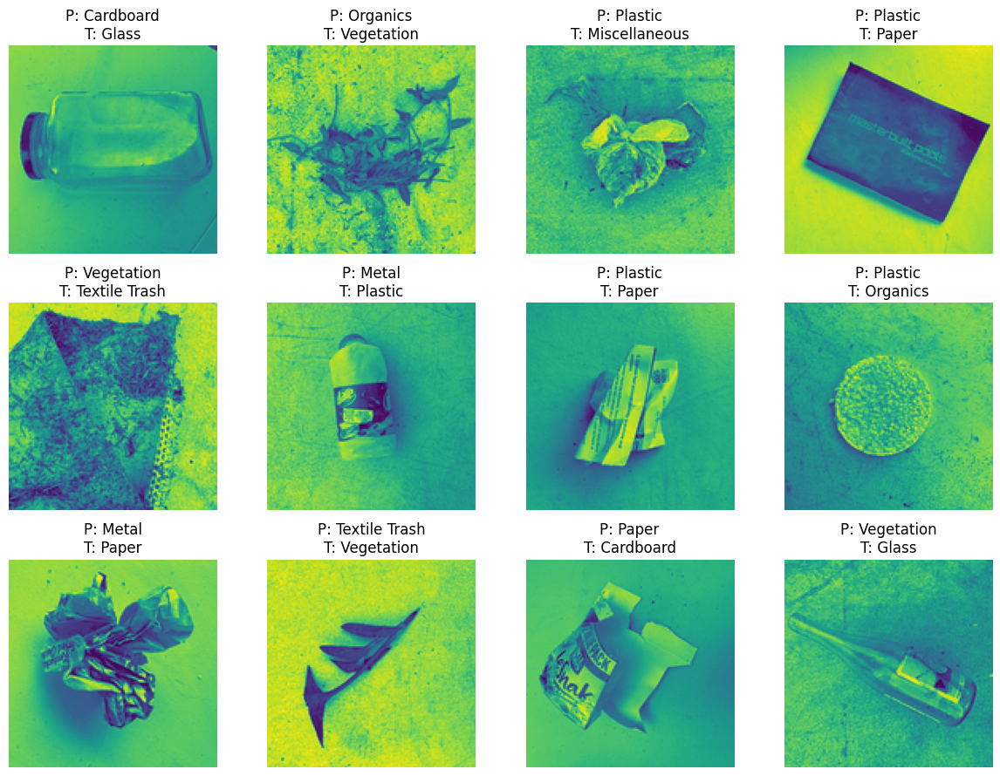

In [28]:
model_evaluation(CNN_4, (X_test, y_test), categories, r_categories, 12)

Here, overall accuracy rose from 0.29 to 0.55 - again, an astonishing improvement.  The confusion matrix illustrates a tendency to overpredict metal and plastic.

In [29]:
CNN_model_5 = Sequential([
    Conv2D(128,(3,3),padding='same',activation='relu',input_shape=(131,131,1)),
    MaxPooling2D(),
    Conv2D(64,(3,3),padding='same',activation='relu'),
    MaxPooling2D(),
    Conv2D(64,(3,3),padding='same',activation='relu'),
    MaxPooling2D(),
    Flatten(),
    Dense(1024,activation='relu'),
    Dense(512,activation='relu'),
    Dense(256,activation='relu'),
    Dropout(0.2),
    Dense(256,activation='relu'),
    Dropout(0.1),
    Dense(9,activation='softmax')
    ])

#CNN_model_5.summary()

In [30]:
CNN_model_5.compile(
    optimizer=Adam(learning_rate=0.0000175),
    loss = 'sparse_categorical_crossentropy',
    metrics=['accuracy']
)
CNN_5 = CNNModel(CNN_model_5, "basic CNN 5")
CNN_5.fit_model(train_data=(X_train_aug, y_train_aug), validation_data=(X_test, y_test), epochs=20)

Epoch 1/20
238/238 [==============================] - 8s 31ms/step - loss: 2.3756 - accuracy: 0.1985 - val_loss: 1.9552 - val_accuracy: 0.2639
Epoch 2/20
238/238 [==============================] - 7s 29ms/step - loss: 2.0619 - accuracy: 0.2539 - val_loss: 1.7296 - val_accuracy: 0.3491
Epoch 3/20
238/238 [==============================] - 7s 29ms/step - loss: 1.9837 - accuracy: 0.2774 - val_loss: 1.7008 - val_accuracy: 0.4101
Epoch 4/20
238/238 [==============================] - 7s 29ms/step - loss: 1.9084 - accuracy: 0.3085 - val_loss: 1.6068 - val_accuracy: 0.4059
Epoch 5/20
238/238 [==============================] - 7s 29ms/step - loss: 1.8456 - accuracy: 0.3321 - val_loss: 1.5014 - val_accuracy: 0.4700
Epoch 6/20
238/238 [==============================] - 7s 29ms/step - loss: 1.8059 - accuracy: 0.3462 - val_loss: 1.4970 - val_accuracy: 0.4837
Epoch 7/20
238/238 [==============================] - 7s 29ms/step - loss: 1.7325 - accuracy: 0.3733 - val_loss: 1.4573 - val_accuracy: 0.4942

30/30 [==============================] - 0s 4ms/step
               precision    recall  f1-score   support

    Cardboard       0.70      0.49      0.58       104
     Organics       0.59      0.62      0.60        77
        Glass       0.68      0.66      0.67        70
        Metal       0.58      0.76      0.66       159
Miscellaneous       0.43      0.28      0.34       105
        Paper       0.46      0.64      0.53       105
      Plastic       0.68      0.60      0.64       162
Textile Trash       0.35      0.26      0.30        61
   Vegetation       0.72      0.76      0.74       108

     accuracy                           0.59       951
    macro avg       0.57      0.56      0.56       951
 weighted avg       0.59      0.59      0.58       951



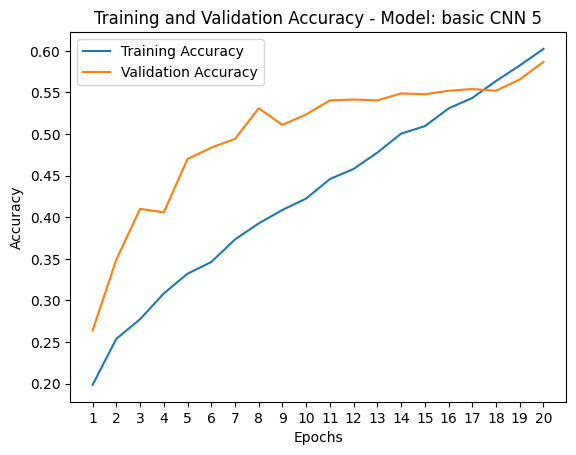

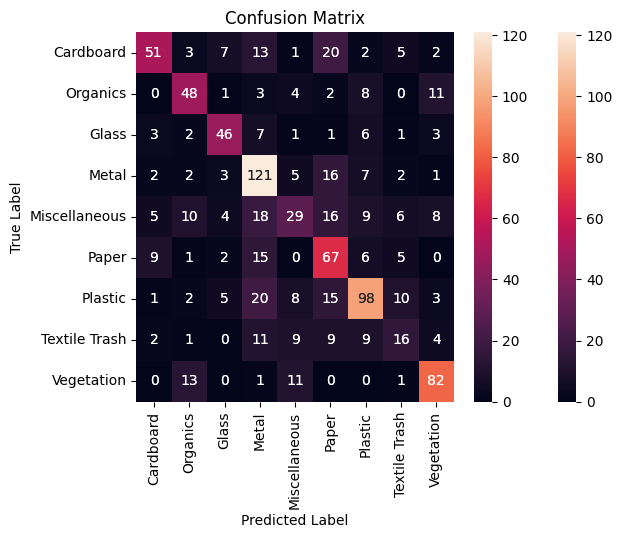

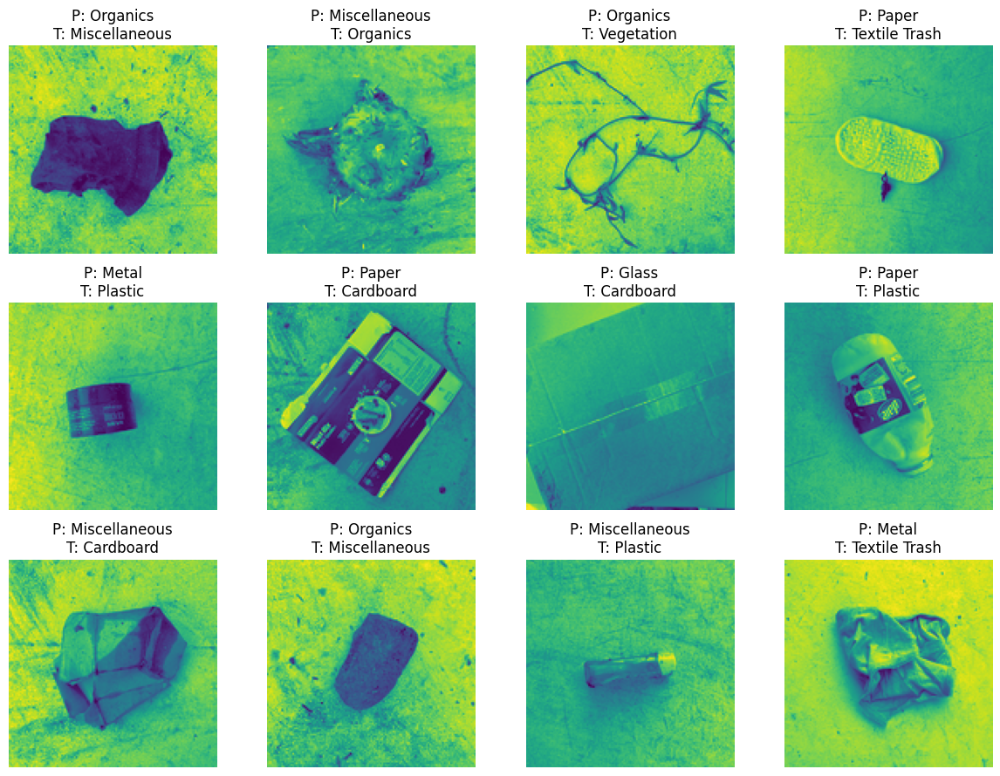

In [31]:
model_evaluation(CNN_5, (X_test, y_test), categories, r_categories, 12)

In [32]:
# let's make these models a little more substantial

CNN_model_6 = Sequential([
    Conv2D(128,(3,3),padding='same',activation='relu',input_shape=(131,131,1)),
    MaxPooling2D(),
    Conv2D(64,(3,3),padding='same',activation='relu'),
    MaxPooling2D(),
    Conv2D(64,(3,3),padding='same',activation='relu'),
    MaxPooling2D(),
    Flatten(),
    Dense(1024,activation='relu'),
    Dense(512,activation='relu'),
    Dense(1024,activation='relu'),
    Dense(512,activation='relu'),
    Dropout(0.2),
    Dense(512,activation='relu'),
    Dense(256,activation='relu'),
    Dropout(0.2),
    Dense(9,activation='softmax')
])

#CNN_model_6.summary()

In [33]:
CNN_model_6.compile(
    optimizer=Adam(learning_rate=0.0000175),
    loss = 'sparse_categorical_crossentropy',
    metrics=['accuracy']
)

# it could be time to include this
tf.keras.backend.clear_session()
gc.collect()

CNN_6 = CNNModel(CNN_model_6, "basic CNN 6")
CNN_6.fit_model(train_data=(X_train_aug, y_train_aug), validation_data=(X_test, y_test), epochs=20)

Epoch 1/20
238/238 [==============================] - 8s 32ms/step - loss: 2.2456 - accuracy: 0.1940 - val_loss: 1.9891 - val_accuracy: 0.2713
Epoch 2/20
238/238 [==============================] - 7s 29ms/step - loss: 2.0739 - accuracy: 0.2451 - val_loss: 1.8473 - val_accuracy: 0.3239
Epoch 3/20
238/238 [==============================] - 7s 29ms/step - loss: 1.9894 - accuracy: 0.2774 - val_loss: 1.7065 - val_accuracy: 0.3933
Epoch 4/20
238/238 [==============================] - 7s 29ms/step - loss: 1.9288 - accuracy: 0.2965 - val_loss: 1.6047 - val_accuracy: 0.3891
Epoch 5/20
238/238 [==============================] - 7s 29ms/step - loss: 1.8647 - accuracy: 0.3243 - val_loss: 1.5316 - val_accuracy: 0.4784
Epoch 6/20
238/238 [==============================] - 7s 29ms/step - loss: 1.8177 - accuracy: 0.3412 - val_loss: 1.5317 - val_accuracy: 0.4532
Epoch 7/20
238/238 [==============================] - 7s 29ms/step - loss: 1.7477 - accuracy: 0.3703 - val_loss: 1.4723 - val_accuracy: 0.4742

30/30 [==============================] - 0s 4ms/step
               precision    recall  f1-score   support

    Cardboard       0.62      0.49      0.55       104
     Organics       0.53      0.73      0.61        77
        Glass       0.61      0.63      0.62        70
        Metal       0.75      0.48      0.59       159
Miscellaneous       0.41      0.26      0.32       105
        Paper       0.48      0.53      0.51       105
      Plastic       0.52      0.63      0.57       162
Textile Trash       0.27      0.51      0.35        61
   Vegetation       0.80      0.71      0.75       108

     accuracy                           0.55       951
    macro avg       0.56      0.55      0.54       951
 weighted avg       0.58      0.55      0.55       951



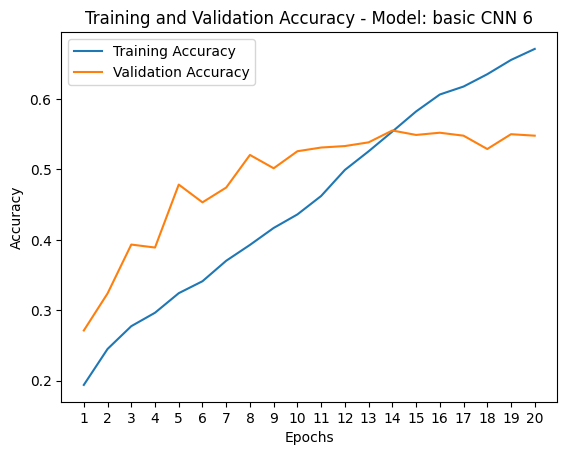

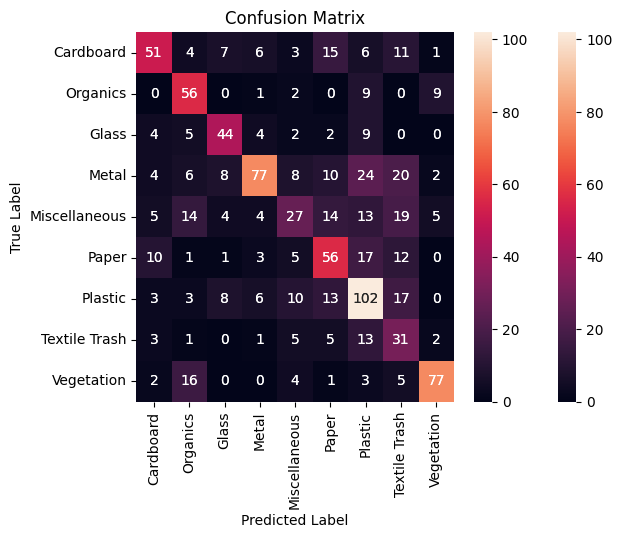

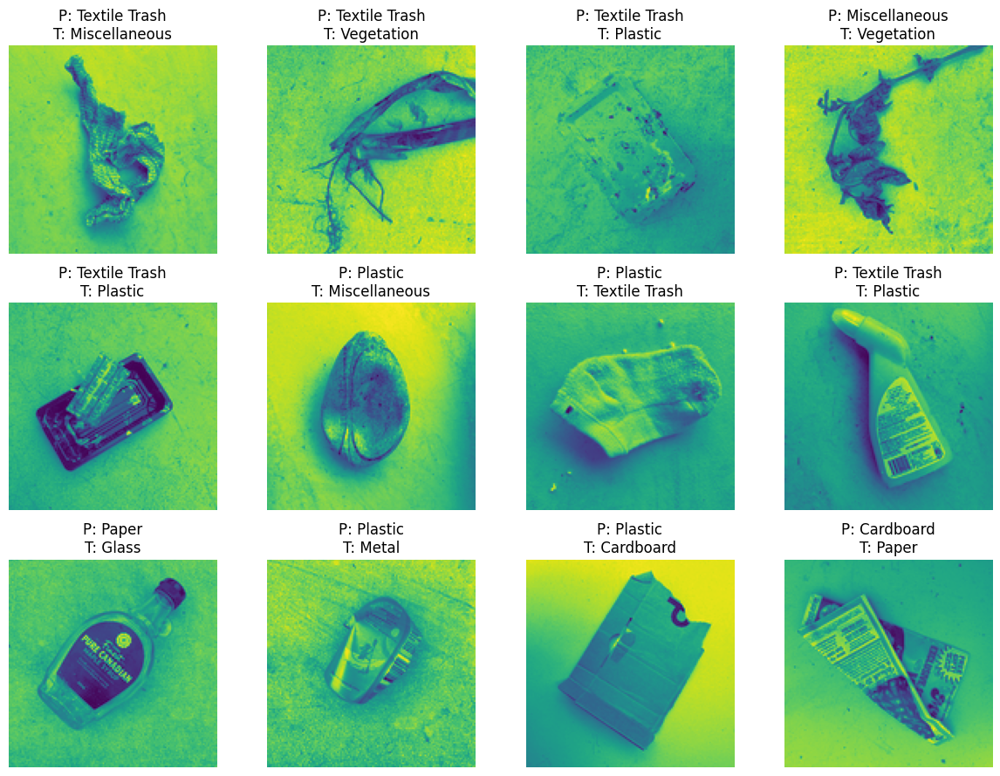

In [34]:
model_evaluation(CNN_6, (X_test, y_test), categories, r_categories, 12)

In [35]:
# what happens if we have a larger kernel size?

CNN_model_7 = Sequential([
    Conv2D(128,(5,5),padding='same',activation='relu',input_shape=(131,131,1)),
    MaxPooling2D(),
    Conv2D(64,(5,5),padding='same',activation='relu'),
    MaxPooling2D(),
    Conv2D(64,(5,5),padding='same',activation='relu'),
    MaxPooling2D(),
    Flatten(),
    Dense(1024,activation='relu'),
    Dense(512,activation='relu'),
    Dense(1024,activation='relu'),
    Dense(512,activation='relu'),
    Dropout(0.2),
    Dense(512,activation='relu'),
    Dense(256,activation='relu'),
    Dropout(0.1),
    Dense(9,activation='softmax')
])

#CNN_model_7.summary()

In [36]:
CNN_model_7.compile(
    optimizer=Adam(learning_rate=0.0000175),
    loss = 'sparse_categorical_crossentropy',
    metrics=['accuracy']
)


tf.keras.backend.clear_session()
gc.collect()


CNN_7 = CNNModel(CNN_model_7, "basic CNN 7")
CNN_7.fit_model(train_data=(X_train_aug, y_train_aug), validation_data=(X_test, y_test), epochs=20)

Epoch 1/20
238/238 [==============================] - 10s 36ms/step - loss: 2.1935 - accuracy: 0.2052 - val_loss: 1.9433 - val_accuracy: 0.2629
Epoch 2/20
238/238 [==============================] - 8s 36ms/step - loss: 2.0342 - accuracy: 0.2589 - val_loss: 1.6861 - val_accuracy: 0.3912
Epoch 3/20
238/238 [==============================] - 8s 35ms/step - loss: 1.9357 - accuracy: 0.2962 - val_loss: 1.6806 - val_accuracy: 0.3870
Epoch 4/20
238/238 [==============================] - 9s 36ms/step - loss: 1.8673 - accuracy: 0.3236 - val_loss: 1.5130 - val_accuracy: 0.4637
Epoch 5/20
238/238 [==============================] - 9s 36ms/step - loss: 1.7975 - accuracy: 0.3500 - val_loss: 1.4880 - val_accuracy: 0.4711
Epoch 6/20
238/238 [==============================] - 9s 36ms/step - loss: 1.7517 - accuracy: 0.3607 - val_loss: 1.3649 - val_accuracy: 0.5226
Epoch 7/20
238/238 [==============================] - 9s 38ms/step - loss: 1.6901 - accuracy: 0.3806 - val_loss: 1.3674 - val_accuracy: 0.515

30/30 [==============================] - 0s 5ms/step
               precision    recall  f1-score   support

    Cardboard       0.59      0.46      0.52       104
     Organics       0.53      0.61      0.57        77
        Glass       0.69      0.71      0.70        70
        Metal       0.59      0.65      0.62       159
Miscellaneous       0.34      0.37      0.36       105
        Paper       0.54      0.49      0.51       105
      Plastic       0.50      0.59      0.54       162
Textile Trash       0.33      0.33      0.33        61
   Vegetation       0.82      0.54      0.65       108

     accuracy                           0.54       951
    macro avg       0.55      0.53      0.53       951
 weighted avg       0.55      0.54      0.54       951



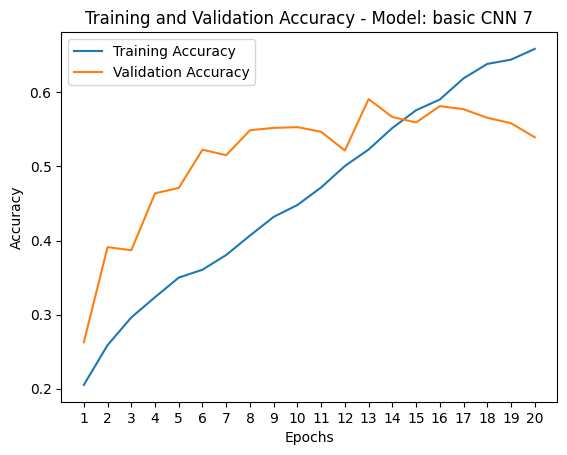

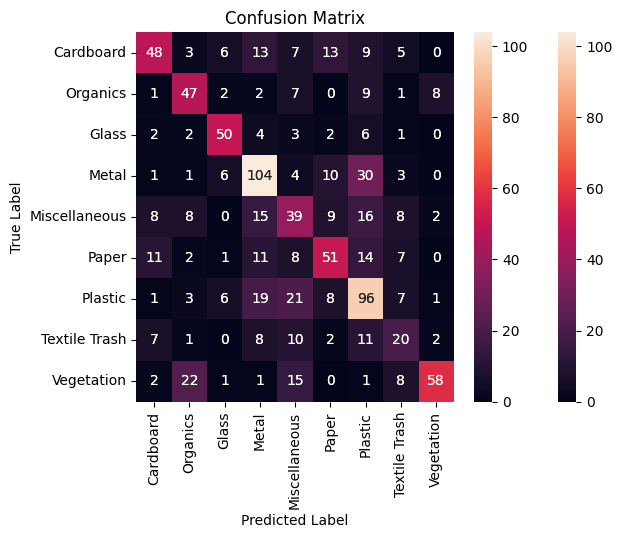

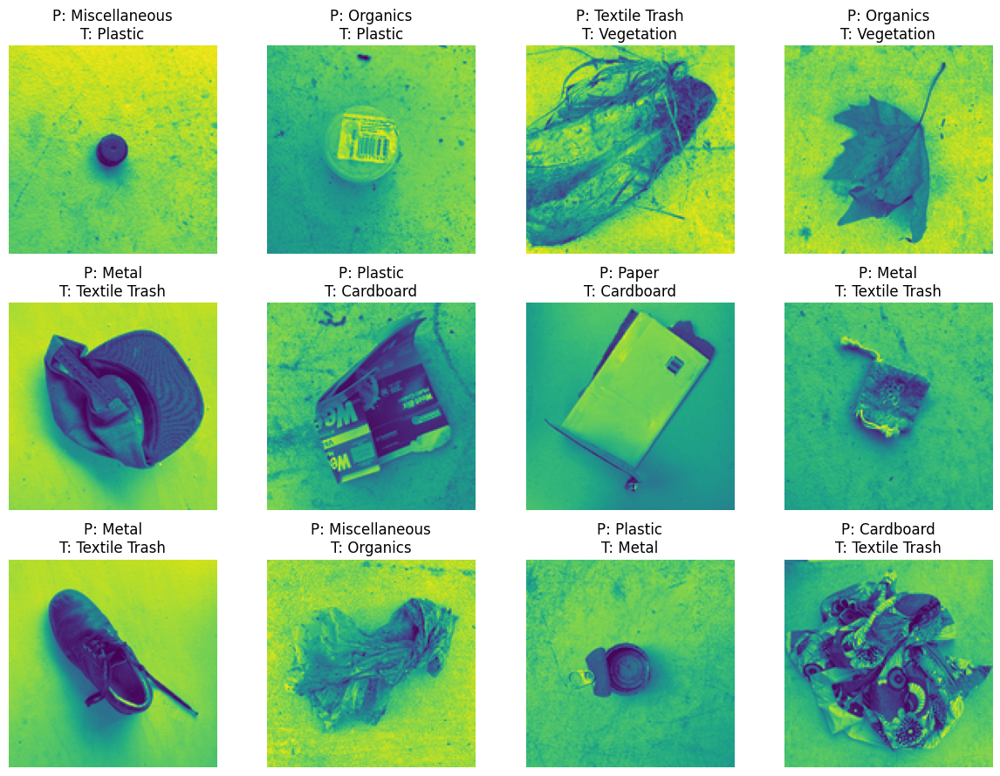

In [37]:
model_evaluation(CNN_7, (X_test, y_test), categories, r_categories, 12)

In [38]:
CNN_model_8 = Sequential([
    Conv2D(128,(5,5),padding='same',activation='relu',input_shape=(131,131,1)),
    MaxPooling2D(),
    Conv2D(64,(5,5),padding='same',activation='relu'),
    MaxPooling2D(),
    Conv2D(32,(5,5),padding='same',activation='relu'),
    MaxPooling2D(),
    Flatten(),
    Dense(1024,activation='relu'),
    Dense(512,activation='relu'),
    Dense(1024,activation='relu'),
    Dropout(0.2),
    Dense(1024,activation='relu'),
    Dense(512,activation='relu'),
    Dropout(0.1),
    Dense(256,activation='relu'),
    Dense(9,activation='softmax')
])

#CNN_model_8.summary()


In [39]:
CNN_model_8.compile(
    optimizer=Adam(learning_rate=0.0000175),
    loss = 'sparse_categorical_crossentropy',
    metrics=['accuracy']
)



CNN_8 = CNNModel(CNN_model_8, "basic CNN 8")
CNN_8.fit_model(train_data=(X_train_aug, y_train_aug), validation_data=(X_test, y_test), epochs=20)

Epoch 1/20
238/238 [==============================] - 9s 35ms/step - loss: 2.2071 - accuracy: 0.2026 - val_loss: 1.9506 - val_accuracy: 0.2650
Epoch 2/20
238/238 [==============================] - 8s 32ms/step - loss: 2.0334 - accuracy: 0.2607 - val_loss: 1.7308 - val_accuracy: 0.3586
Epoch 3/20
238/238 [==============================] - 8s 32ms/step - loss: 1.9583 - accuracy: 0.2793 - val_loss: 1.6430 - val_accuracy: 0.3964
Epoch 4/20
238/238 [==============================] - 8s 32ms/step - loss: 1.8781 - accuracy: 0.3162 - val_loss: 1.5689 - val_accuracy: 0.4111
Epoch 5/20
238/238 [==============================] - 8s 33ms/step - loss: 1.8238 - accuracy: 0.3345 - val_loss: 1.4617 - val_accuracy: 0.4963
Epoch 6/20
238/238 [==============================] - 8s 32ms/step - loss: 1.7799 - accuracy: 0.3524 - val_loss: 1.4873 - val_accuracy: 0.4511
Epoch 7/20
238/238 [==============================] - 8s 32ms/step - loss: 1.7252 - accuracy: 0.3716 - val_loss: 1.4309 - val_accuracy: 0.4879

30/30 [==============================] - 0s 5ms/step
               precision    recall  f1-score   support

    Cardboard       0.61      0.36      0.45       104
     Organics       0.55      0.70      0.61        77
        Glass       0.85      0.56      0.67        70
        Metal       0.56      0.74      0.63       159
Miscellaneous       0.36      0.43      0.39       105
        Paper       0.51      0.52      0.52       105
      Plastic       0.54      0.57      0.56       162
Textile Trash       0.39      0.20      0.26        61
   Vegetation       0.80      0.74      0.77       108

     accuracy                           0.56       951
    macro avg       0.57      0.53      0.54       951
 weighted avg       0.57      0.56      0.55       951



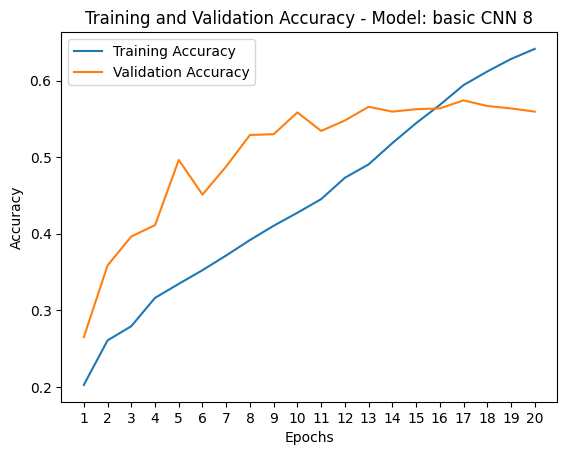

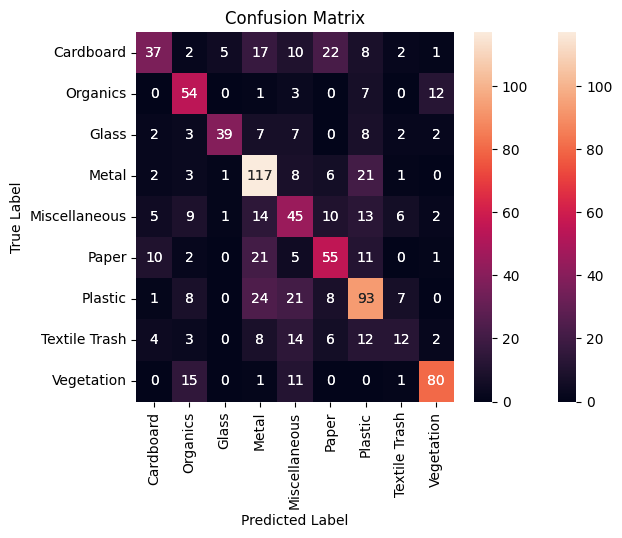

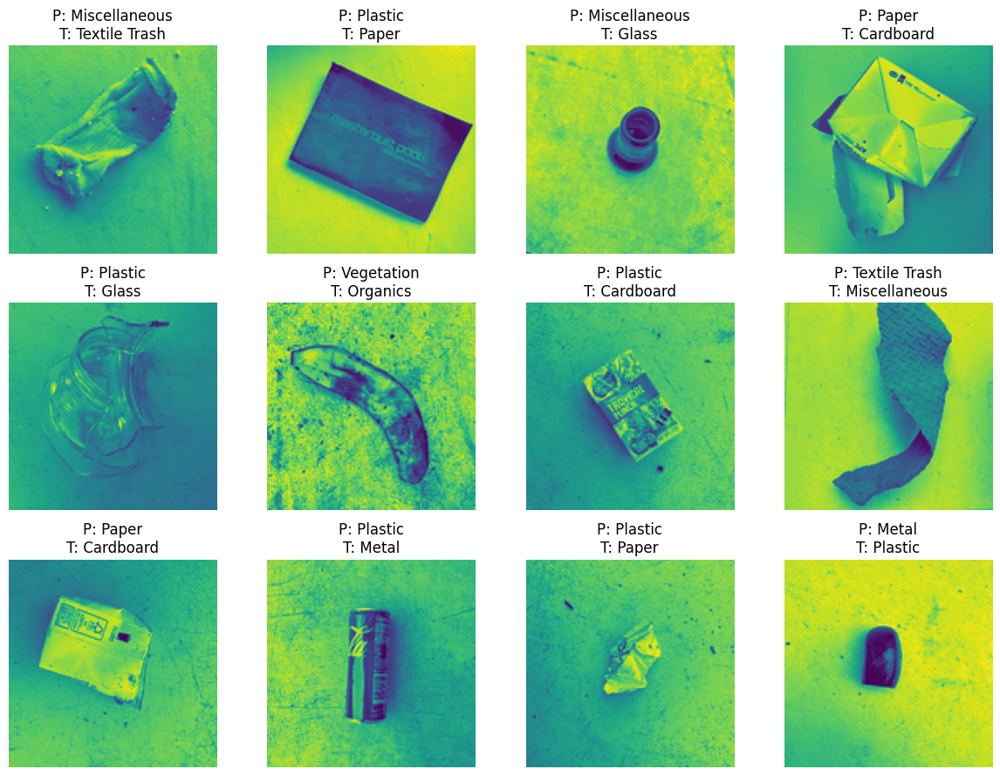

In [40]:
model_evaluation(CNN_8, (X_test, y_test), categories, r_categories, 12)

## Transfer Learning Models

## InceptionV3

A brief investigation reveals that InceptionV3 is designed for RGB images! It's possible to modify the model (it is of course on GitHub) to take monochrome input, and doing this might be worthwhile - but, importantly, the "imagenet" weights (and indeed any other pretrained weights) are trained on 3-channel inputs. The training weights would be, then, pretty much worthless, and training such a model from scratch would take a great deal of processor time, on a system that gets far more mileage out of that time than this machine ever will.

The only other solution seems to be to go back to preprocessing and revert all images to RGB, which will, of course, radically increase run times, and chip away at accuracy for my naive models. I really want to try InceptionV3, so I revised my preprocessing notebook and saved some RGB images.



In [14]:
# it became evident that GPU RAM was going to be an issue
import gc
gc.collect()

del X_train_aug
del y_train_aug
del X_test
del y_test


In [15]:
# went back to preprocessing, removed grayscale conversion, and saved RGB images


# Get the path to the current data files
notebook_path = os.path.abspath('02-cnn-waste-classification-modeling.ipynb')
project_root = os.path.dirname(os.path.dirname(notebook_path))
load_dir = os.path.join(project_root, 'data')



with open(os.path.join(load_dir, 'RealWaste_X_train_aug_RGB.pkl'), 'rb') as fh:
    X_train_aug_RGB = pickle.load(fh)

with open(os.path.join(load_dir, 'RealWaste_X_test_RGB.pkl'), 'rb') as fh:
    X_test_RGB = pickle.load(fh)

with open(os.path.join(load_dir, 'RealWaste_y_train_aug_RGB.pkl'), 'rb') as fh:
    y_train_aug_RGB = pickle.load(fh)

with open(os.path.join(load_dir, 'RealWaste_y_test_RGB.pkl'), 'rb') as fh:
    y_test_RGB = pickle.load(fh)

In [16]:
X_train_aug_RGB = np.asarray(X_train_aug_RGB)
X_test_RGB = np.asarray(X_test_RGB)
y_train_aug_RGB = np.asarray(y_train_aug_RGB)
y_test_RGB = np.asarray(y_test_RGB)

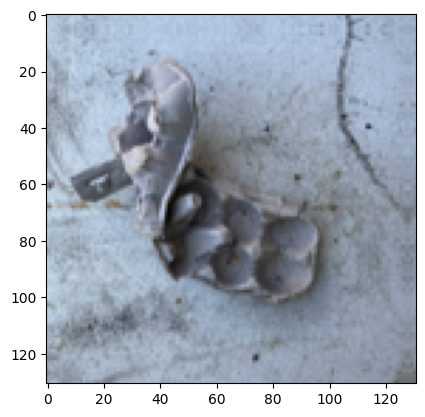

In [17]:
# verify
plt.imshow(X_train_aug_RGB[2194])

In [45]:
# IV3 requires an input_shape parameter

input_s = (131, 131, 3)
IV3 = InceptionV3(include_top = False, weights = "imagenet", input_shape = input_s)

87910968/87910968 [==============================] - 105s 1us/step


In [46]:
# a very simple IV3 model to start 

IV3_model_1 = Sequential([IV3])
for layer in IV3_model_1.layers:
    layer.trainable = False

# flatten, add final dense layer, add softmax layer
    
IV3_model_1.add(Flatten())    
IV3_model_1.add(Dense(512, activation='relu'))
IV3_model_1.add(Dense(1024, activation='relu'))
IV3_model_1.add(Dense(512, activation='relu'))
IV3_model_1.add(Dropout(0.2))
IV3_model_1.add(Dense(256, activation='relu'))
IV3_model_1.add(Dense(9, activation='softmax'))

#IV3_model_1.summary()
#visualkeras.layered_view(IV3_model_1, legend=True)

In [47]:
gc.collect()
tf.keras.backend.clear_session()
IV3_model_1.compile(optimizer = Adam(learning_rate=0.0000175), loss = "sparse_categorical_crossentropy", metrics = ["accuracy"])
IV3_1 = CNNModel(IV3_model_1, "IV3 model 1")
IV3_1.fit_model(train_data=(X_train_aug_RGB, y_train_aug_RGB), validation_data=(X_test_RGB, y_test_RGB), epochs=20, batch_size=16)

Epoch 1/20
476/476 [==============================] - 8s 12ms/step - loss: 5.8358 - accuracy: 0.2081 - val_loss: 3.4959 - val_accuracy: 0.3155
Epoch 2/20
476/476 [==============================] - 4s 9ms/step - loss: 2.7512 - accuracy: 0.3148 - val_loss: 2.6622 - val_accuracy: 0.2913
Epoch 3/20
476/476 [==============================] - 4s 9ms/step - loss: 2.0939 - accuracy: 0.4031 - val_loss: 2.3023 - val_accuracy: 0.3386
Epoch 4/20
476/476 [==============================] - 4s 9ms/step - loss: 1.8057 - accuracy: 0.4495 - val_loss: 2.1298 - val_accuracy: 0.3396
Epoch 5/20
476/476 [==============================] - 4s 9ms/step - loss: 1.5815 - accuracy: 0.4868 - val_loss: 2.0347 - val_accuracy: 0.3680
Epoch 6/20
476/476 [==============================] - 4s 9ms/step - loss: 1.4482 - accuracy: 0.5254 - val_loss: 1.9635 - val_accuracy: 0.3533
Epoch 7/20
476/476 [==============================] - 4s 9ms/step - loss: 1.3500 - accuracy: 0.5431 - val_loss: 1.9991 - val_accuracy: 0.3775
Epoch

30/30 [==============================] - 1s 10ms/step
               precision    recall  f1-score   support

    Cardboard       0.39      0.27      0.32       104
     Organics       0.59      0.51      0.55        77
        Glass       0.43      0.63      0.51        70
        Metal       0.43      0.58      0.49       159
Miscellaneous       0.33      0.16      0.22       105
        Paper       0.40      0.35      0.38       105
      Plastic       0.39      0.52      0.45       162
Textile Trash       0.35      0.23      0.28        61
   Vegetation       0.58      0.52      0.55       108

     accuracy                           0.43       951
    macro avg       0.43      0.42      0.41       951
 weighted avg       0.43      0.43      0.42       951



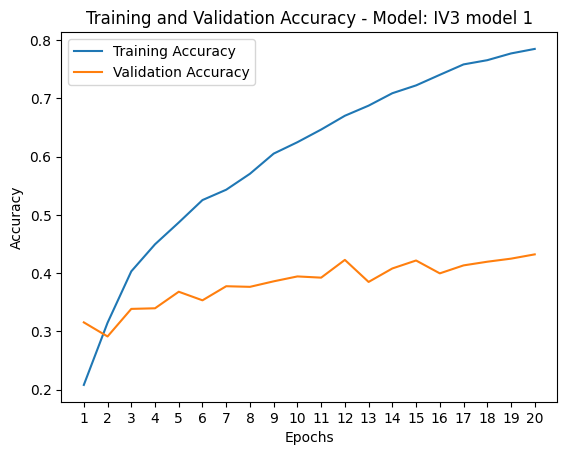

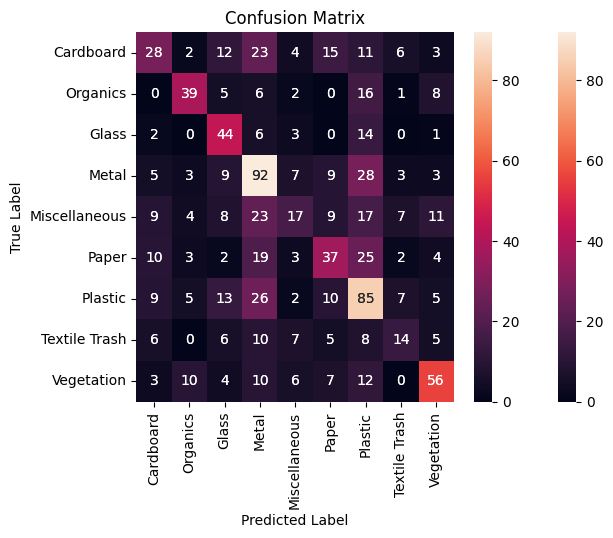

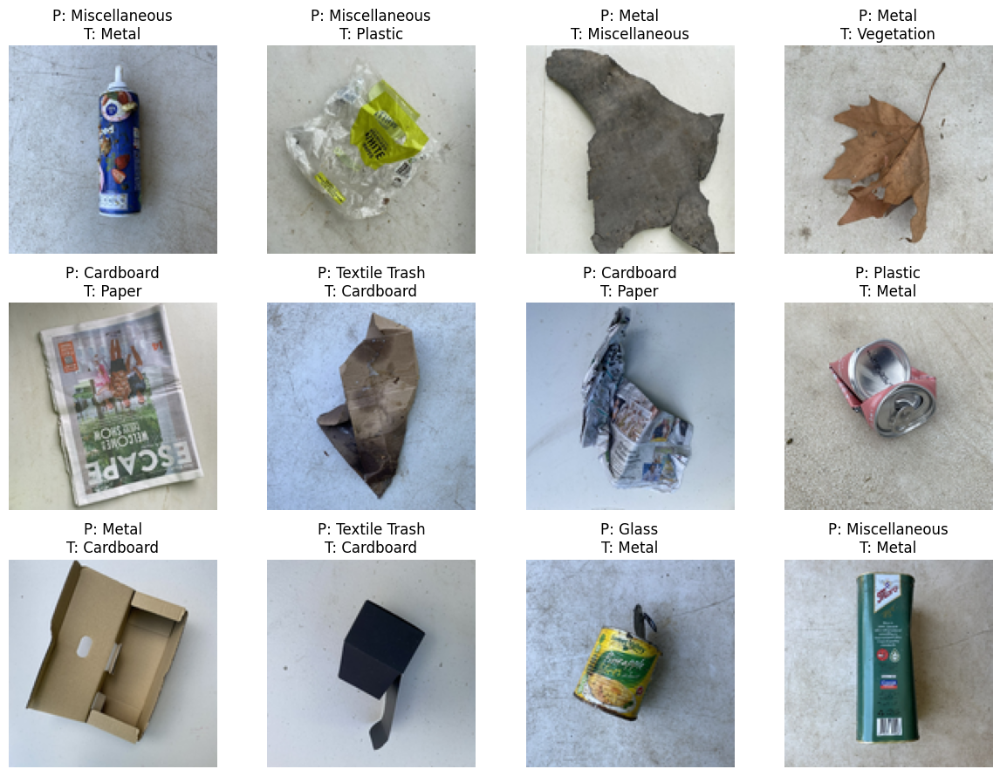

In [48]:
model_evaluation(IV3_1, (X_test_RGB, y_test_RGB), categories, r_categories, 12)

In [49]:
# if at some point I'm going to make IV3 layers trainable, it's probably prudent 
# to get in the habit of instantiating them afresh for each model


input_s = (131, 131, 3)
IV3 = InceptionV3(include_top = False, weights = "imagenet", input_shape = input_s)

IV3_model_2 = Sequential([IV3])

# keeping them untrainable, for now
for layer in IV3_model_2.layers:
    layer.trainable = False

# flatten, add final dense layer, add softmax layer
    
IV3_model_2.add(Flatten())
IV3_model_2.add(Dense(512, activation='relu'))
IV3_model_2.add(Dense(1024, activation='relu'))
IV3_model_2.add(Dense(512, activation='relu'))
IV3_model_2.add(Dropout(0.2))
IV3_model_2.add(Dense(512, activation='relu'))
IV3_model_2.add(Dropout(0.2))
IV3_model_2.add(Dense(9, activation='softmax'))

#IV3_model_2.summary()



In [50]:
gc.collect()
tf.keras.backend.clear_session()
IV3_model_2.compile(optimizer = Adam(learning_rate=0.0000175), loss = "sparse_categorical_crossentropy", metrics = ["accuracy"])
IV3_2 = CNNModel(IV3_model_2, "IV3 model 2")
IV3_2.fit_model(train_data=(X_train_aug_RGB, y_train_aug_RGB), validation_data=(X_test_RGB, y_test_RGB), epochs=20, batch_size=16)

Epoch 1/20
476/476 [==============================] - 7s 11ms/step - loss: 5.7134 - accuracy: 0.2034 - val_loss: 2.8216 - val_accuracy: 0.2850
Epoch 2/20
476/476 [==============================] - 4s 9ms/step - loss: 2.6763 - accuracy: 0.2851 - val_loss: 2.2742 - val_accuracy: 0.2818
Epoch 3/20
476/476 [==============================] - 4s 9ms/step - loss: 2.1166 - accuracy: 0.3564 - val_loss: 2.0445 - val_accuracy: 0.3365
Epoch 4/20
476/476 [==============================] - 4s 9ms/step - loss: 1.8186 - accuracy: 0.4150 - val_loss: 1.9420 - val_accuracy: 0.3407
Epoch 5/20
476/476 [==============================] - 4s 9ms/step - loss: 1.6402 - accuracy: 0.4520 - val_loss: 1.8955 - val_accuracy: 0.3523
Epoch 6/20
476/476 [==============================] - 4s 9ms/step - loss: 1.5061 - accuracy: 0.4904 - val_loss: 1.8520 - val_accuracy: 0.3628
Epoch 7/20
476/476 [==============================] - 4s 9ms/step - loss: 1.4164 - accuracy: 0.5093 - val_loss: 1.8572 - val_accuracy: 0.3491
Epoch

30/30 [==============================] - 1s 7ms/step
               precision    recall  f1-score   support

    Cardboard       0.36      0.34      0.35       104
     Organics       0.49      0.56      0.52        77
        Glass       0.62      0.40      0.49        70
        Metal       0.46      0.59      0.52       159
Miscellaneous       0.34      0.21      0.26       105
        Paper       0.51      0.28      0.36       105
      Plastic       0.35      0.62      0.44       162
Textile Trash       0.45      0.25      0.32        61
   Vegetation       0.62      0.44      0.51       108

     accuracy                           0.43       951
    macro avg       0.47      0.41      0.42       951
 weighted avg       0.45      0.43      0.43       951



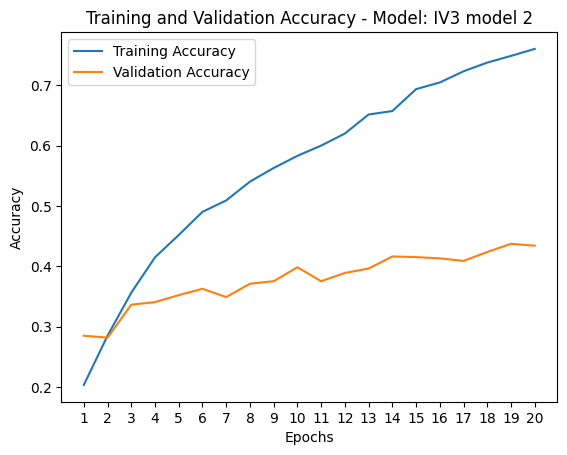

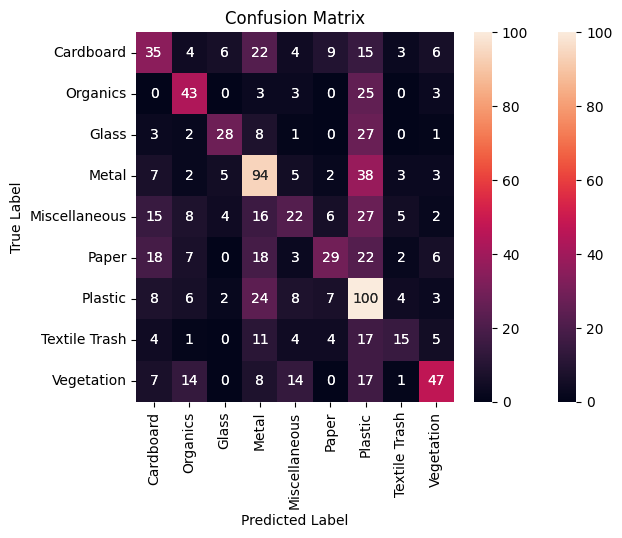

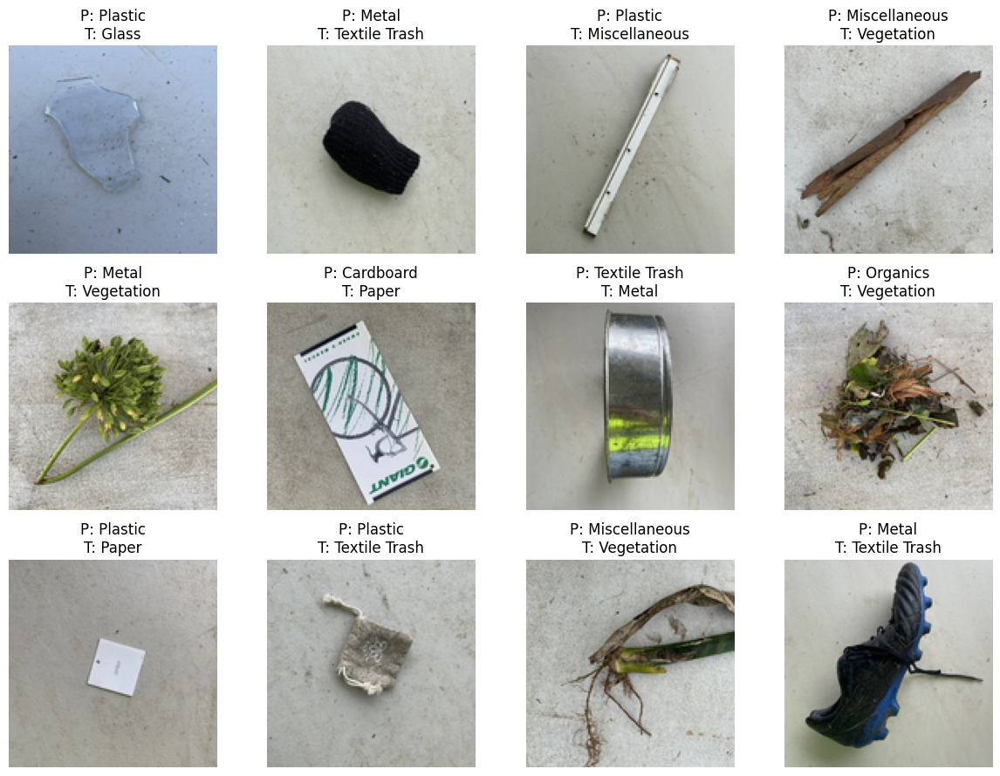

In [51]:
model_evaluation(IV3_2, (X_test_RGB, y_test_RGB), categories, r_categories, 12)

In [52]:
# tinkering with the Dense layers
input_s = (131, 131, 3)
IV3 = InceptionV3(include_top = False, weights = "imagenet", input_shape = input_s)

IV3_model_3 = Sequential([IV3])

# keeping them untrainable, for now
for layer in IV3_model_3.layers:
    layer.trainable = False


# flatten, add final dense layer, add softmax layer
    
IV3_model_3.add(Flatten())
IV3_model_3.add(Dense(1024, activation='relu'))
IV3_model_3.add(Dense(1024, activation='relu'))
IV3_model_3.add(Dense(1024, activation='relu'))
IV3_model_3.add(Dense(1024, activation='relu'))
IV3_model_3.add(Dense(512, activation='relu'))
IV3_model_3.add(Dense(256, activation='relu'))
IV3_model_3.add(Dropout(0.1))
IV3_model_3.add(Dense(256, activation='relu'))
IV3_model_3.add(Dense(256, activation='relu'))
IV3_model_3.add(Dense(256, activation='relu'))
IV3_model_3.add(Dense(256, activation='relu'))
IV3_model_3.add(Dropout(0.1))
IV3_model_3.add(Dense(256, activation='relu'))
IV3_model_3.add(Dense(9, activation='softmax'))

#IV3_model_3.summary()


In [53]:
gc.collect()
tf.keras.backend.clear_session()
IV3_model_3.compile(optimizer = Adam(learning_rate=0.0000175), loss = "sparse_categorical_crossentropy", metrics = ["accuracy"])
IV3_3 = CNNModel(IV3_model_3, "IV3 model 3")
IV3_3.fit_model(train_data=(X_train_aug_RGB, y_train_aug_RGB), validation_data=(X_test_RGB, y_test_RGB), epochs=20, batch_size=16)

Epoch 1/20
476/476 [==============================] - 10s 15ms/step - loss: 2.1858 - accuracy: 0.1967 - val_loss: 1.9828 - val_accuracy: 0.2902
Epoch 2/20
476/476 [==============================] - 6s 12ms/step - loss: 2.0053 - accuracy: 0.2544 - val_loss: 1.9530 - val_accuracy: 0.2818
Epoch 3/20
476/476 [==============================] - 6s 12ms/step - loss: 1.8767 - accuracy: 0.3285 - val_loss: 1.8368 - val_accuracy: 0.3649
Epoch 4/20
476/476 [==============================] - 6s 12ms/step - loss: 1.7329 - accuracy: 0.3940 - val_loss: 1.8422 - val_accuracy: 0.3333
Epoch 5/20
476/476 [==============================] - 6s 12ms/step - loss: 1.5779 - accuracy: 0.4442 - val_loss: 1.7734 - val_accuracy: 0.3764
Epoch 6/20
476/476 [==============================] - 6s 12ms/step - loss: 1.4635 - accuracy: 0.4837 - val_loss: 1.8147 - val_accuracy: 0.3596
Epoch 7/20
476/476 [==============================] - 6s 12ms/step - loss: 1.3731 - accuracy: 0.5088 - val_loss: 1.7997 - val_accuracy: 0.378

30/30 [==============================] - 1s 8ms/step
               precision    recall  f1-score   support

    Cardboard       0.44      0.39      0.41       104
     Organics       0.43      0.61      0.50        77
        Glass       0.62      0.51      0.56        70
        Metal       0.59      0.50      0.54       159
Miscellaneous       0.32      0.20      0.25       105
        Paper       0.47      0.53      0.50       105
      Plastic       0.44      0.48      0.46       162
Textile Trash       0.33      0.34      0.34        61
   Vegetation       0.52      0.64      0.57       108

     accuracy                           0.47       951
    macro avg       0.46      0.47      0.46       951
 weighted avg       0.47      0.47      0.46       951



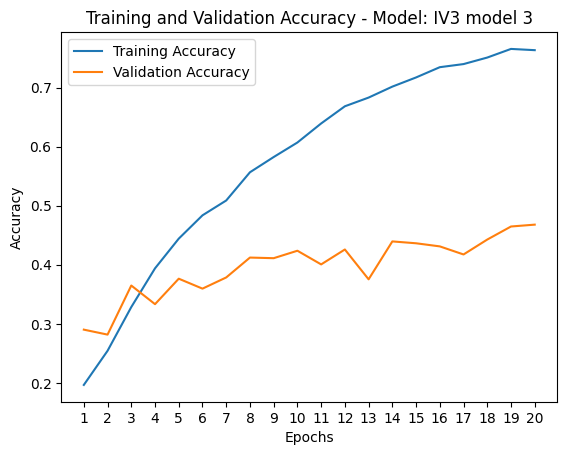

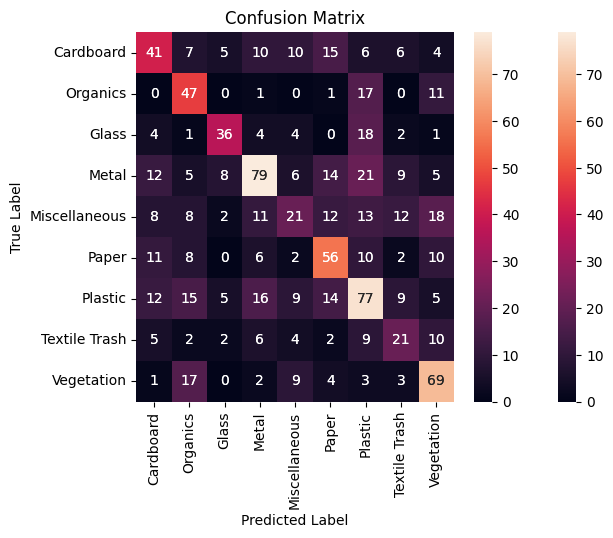

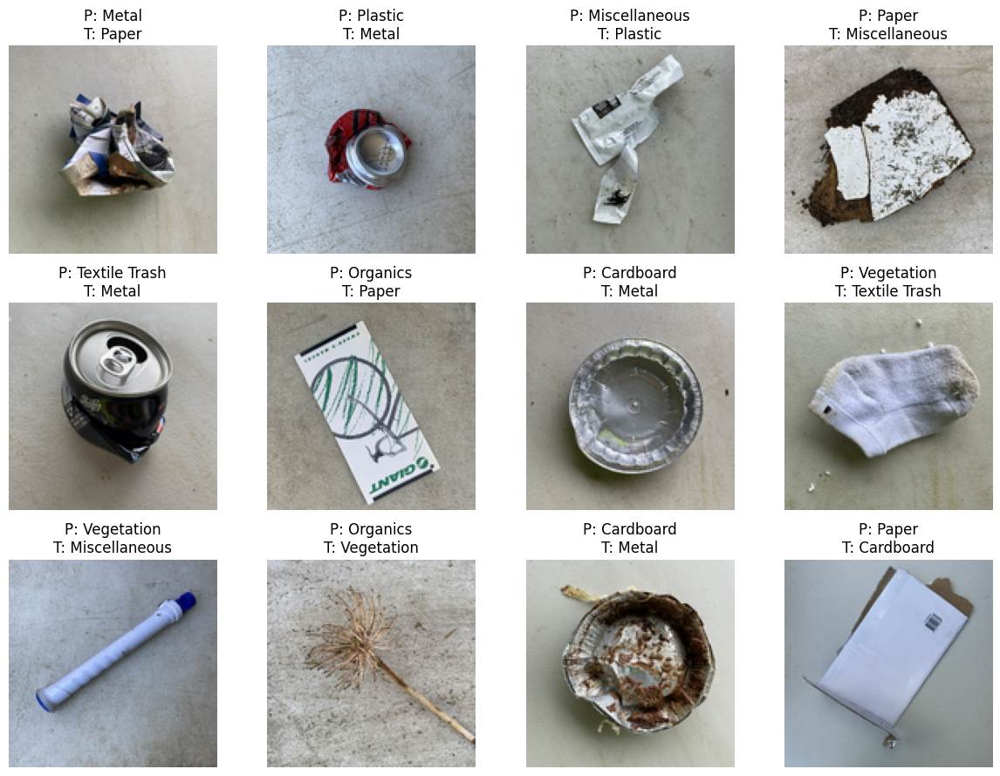

In [54]:
model_evaluation(IV3_3, (X_test_RGB, y_test_RGB), categories, r_categories, 12)

In [55]:
input_s = (131, 131, 3)
IV3 = InceptionV3(include_top = False, weights = "imagenet", input_shape = input_s)

IV3_model_4 = Sequential([IV3])

# keeping them untrainable, for now
for layer in IV3_model_4.layers:
    layer.trainable = False

# flatten, add final dense layers, add dropout layers, softmax layer
    
IV3_model_4.add(Flatten())    
IV3_model_4.add(Dense(1024, activation='relu'))
IV3_model_4.add(Dense(1024, activation='relu'))
IV3_model_4.add(Dense(1024, activation='relu'))
IV3_model_4.add(Dense(1024, activation='relu'))
IV3_model_4.add(Dropout(0.4))
IV3_model_4.add(Dense(1024, activation='relu'))
IV3_model_4.add(Dense(1024, activation='relu'))
IV3_model_4.add(Dense(1024, activation='relu'))
IV3_model_4.add(Dropout(0.2))
IV3_model_4.add(Dense(1024, activation='relu'))
IV3_model_4.add(Dense(1024, activation='relu'))
IV3_model_4.add(Dense(9, activation='softmax'))

#IV3_model_4.summary()


### 

In [56]:
gc.collect()
tf.keras.backend.clear_session()
IV3_model_4.compile(optimizer = Adam(learning_rate=0.0000175), loss = "sparse_categorical_crossentropy", metrics = ["accuracy"])
IV3_4 = CNNModel(IV3_model_4, "IV3 model 4")
IV3_4.fit_model(train_data=(X_train_aug_RGB, y_train_aug_RGB), validation_data=(X_test_RGB, y_test_RGB), epochs=20, batch_size=16)

Epoch 1/20
476/476 [==============================] - 10s 15ms/step - loss: 2.4580 - accuracy: 0.1711 - val_loss: 1.9764 - val_accuracy: 0.2597
Epoch 2/20
476/476 [==============================] - 6s 13ms/step - loss: 2.1536 - accuracy: 0.2185 - val_loss: 1.9190 - val_accuracy: 0.2944
Epoch 3/20
476/476 [==============================] - 6s 13ms/step - loss: 2.0347 - accuracy: 0.2455 - val_loss: 1.8729 - val_accuracy: 0.3470
Epoch 4/20
476/476 [==============================] - 6s 13ms/step - loss: 1.9209 - accuracy: 0.2944 - val_loss: 1.7868 - val_accuracy: 0.3428
Epoch 5/20
476/476 [==============================] - 6s 13ms/step - loss: 1.7771 - accuracy: 0.3656 - val_loss: 1.7791 - val_accuracy: 0.3712
Epoch 6/20
476/476 [==============================] - 6s 13ms/step - loss: 1.6280 - accuracy: 0.4111 - val_loss: 1.7600 - val_accuracy: 0.3796
Epoch 7/20
476/476 [==============================] - 6s 13ms/step - loss: 1.5265 - accuracy: 0.4458 - val_loss: 1.7210 - val_accuracy: 0.376

30/30 [==============================] - 1s 8ms/step
               precision    recall  f1-score   support

    Cardboard       0.57      0.29      0.38       104
     Organics       0.54      0.56      0.55        77
        Glass       0.51      0.51      0.51        70
        Metal       0.49      0.60      0.54       159
Miscellaneous       0.40      0.15      0.22       105
        Paper       0.52      0.41      0.46       105
      Plastic       0.40      0.65      0.49       162
Textile Trash       0.50      0.26      0.34        61
   Vegetation       0.56      0.69      0.62       108

     accuracy                           0.48       951
    macro avg       0.50      0.46      0.46       951
 weighted avg       0.49      0.48      0.47       951



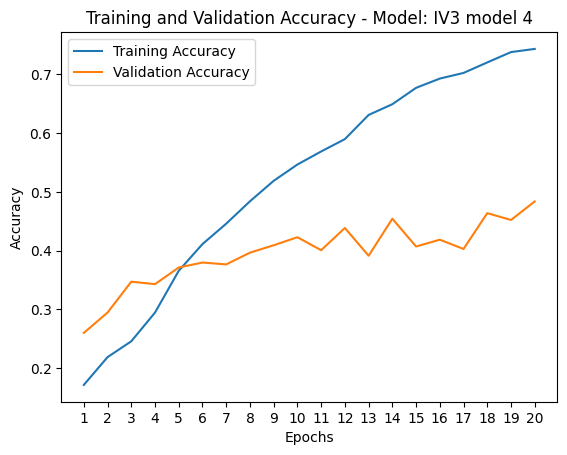

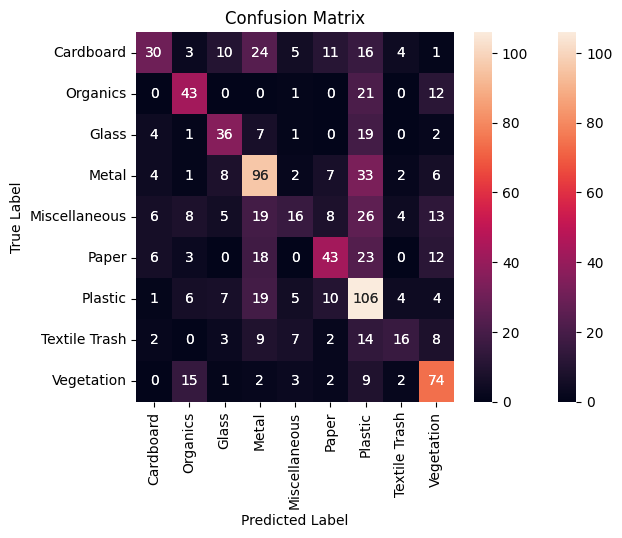

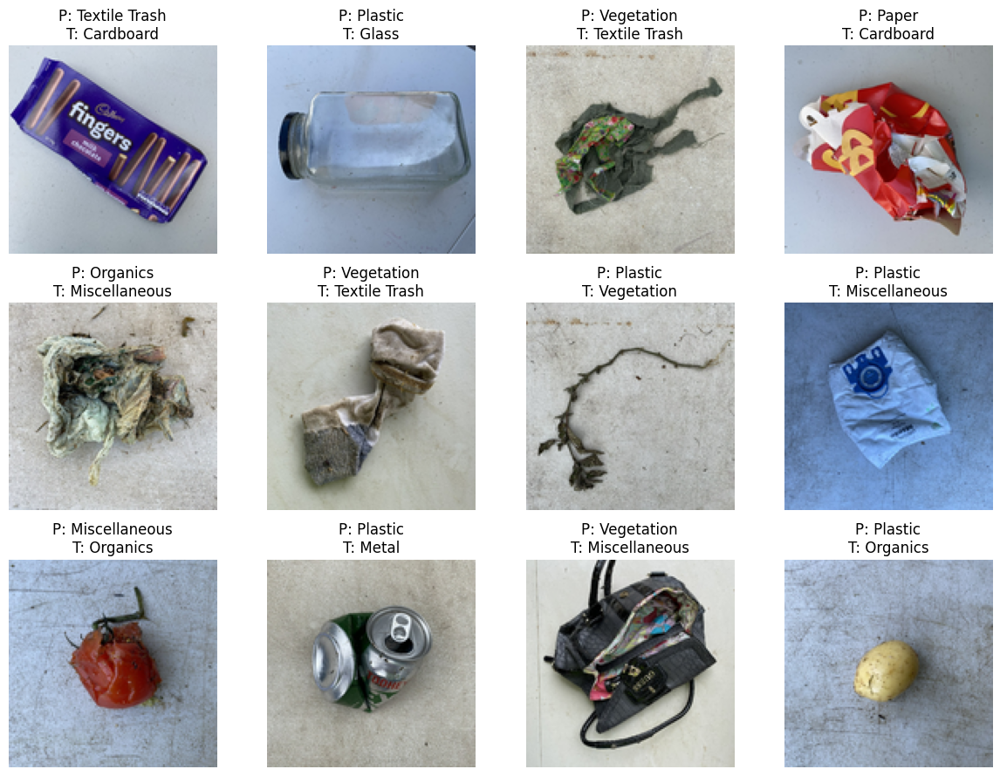

In [57]:
model_evaluation(IV3_4, (X_test_RGB, y_test_RGB), categories, r_categories, 12)

In [18]:
input_s = (131, 131, 3)
IV3 = InceptionV3(include_top = False, weights = "imagenet", input_shape = input_s)

IV3_model_5 = Sequential([IV3])

# keeping them untrainable, for now
for layer in IV3_model_5.layers:
    layer.trainable = False

# flatten, add final dense layers, add dropout layers, softmax layer
    
IV3_model_5.add(Flatten())    
IV3_model_5.add(Dense(2048, activation='relu'))
IV3_model_5.add(Dense(2048, activation='relu'))
IV3_model_5.add(Dropout(0.4))
IV3_model_5.add(Dense(2048, activation='relu'))
IV3_model_5.add(Dense(2048, activation='relu'))
IV3_model_5.add(Dropout(0.2))
IV3_model_5.add(Dense(2048, activation='relu'))
IV3_model_5.add(Dense(2048, activation='relu'))
IV3_model_5.add(Dense(1024, activation='relu'))
IV3_model_5.add(Dense(1024, activation='relu'))
IV3_model_5.add(Dropout(0.2))
IV3_model_5.add(Dense(9, activation='softmax'))

#IV3_model_5.summary()

In [19]:
tf.keras.backend.clear_session()
IV3_model_5.compile(optimizer = Adam(learning_rate=0.0000175), loss = "sparse_categorical_crossentropy", metrics = ["accuracy"])
IV3_5 = CNNModel(IV3_model_5, "IV3 model 5")
IV3_5.fit_model(train_data=(X_train_aug_RGB, y_train_aug_RGB), validation_data=(X_test_RGB, y_test_RGB), epochs=20, batch_size=16)

Epoch 1/20


2025-08-14 18:54:10.226055: I external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:454] Loaded cuDNN version 8906


  1/476 [..............................] - ETA: 26:17 - loss: 10.9844 - accuracy: 0.0000e+00

2025-08-14 18:54:11.132150: I external/local_xla/xla/service/service.cc:168] XLA service 0x7a05ac006360 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
2025-08-14 18:54:11.132184: I external/local_xla/xla/service/service.cc:176]   StreamExecutor device (0): NVIDIA GeForce RTX 4060 Laptop GPU, Compute Capability 8.9
2025-08-14 18:54:11.137261: I tensorflow/compiler/mlir/tensorflow/utils/dump_mlir_util.cc:269] disabling MLIR crash reproducer, set env var `MLIR_CRASH_REPRODUCER_DIRECTORY` to enable.
I0000 00:00:1755197651.185351   12781 device_compiler.h:186] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the process.


476/476 [==============================] - 15s 25ms/step - loss: 3.1968 - accuracy: 0.1707 - val_loss: 1.9758 - val_accuracy: 0.2902
Epoch 2/20
476/476 [==============================] - 11s 23ms/step - loss: 2.2459 - accuracy: 0.2096 - val_loss: 1.9395 - val_accuracy: 0.2766
Epoch 3/20
476/476 [==============================] - 10s 21ms/step - loss: 2.1359 - accuracy: 0.2243 - val_loss: 1.9208 - val_accuracy: 0.2944
Epoch 4/20
476/476 [==============================] - 10s 21ms/step - loss: 2.0423 - accuracy: 0.2391 - val_loss: 1.8791 - val_accuracy: 0.3323
Epoch 5/20
476/476 [==============================] - 10s 21ms/step - loss: 1.9267 - accuracy: 0.3064 - val_loss: 1.8490 - val_accuracy: 0.3533
Epoch 6/20
476/476 [==============================] - 10s 21ms/step - loss: 1.7902 - accuracy: 0.3550 - val_loss: 1.8221 - val_accuracy: 0.3523
Epoch 7/20
476/476 [==============================] - 10s 21ms/step - loss: 1.6656 - accuracy: 0.3962 - val_loss: 1.8006 - val_accuracy: 0.3544
Epo

30/30 [==============================] - 1s 12ms/step
               precision    recall  f1-score   support

    Cardboard       0.44      0.30      0.36       104
     Organics       0.40      0.66      0.50        77
        Glass       0.45      0.60      0.51        70
        Metal       0.49      0.54      0.51       159
Miscellaneous       0.33      0.09      0.14       105
        Paper       0.39      0.49      0.43       105
      Plastic       0.45      0.54      0.49       162
Textile Trash       0.38      0.28      0.32        61
   Vegetation       0.60      0.48      0.53       108

     accuracy                           0.45       951
    macro avg       0.44      0.44      0.42       951
 weighted avg       0.44      0.45      0.43       951



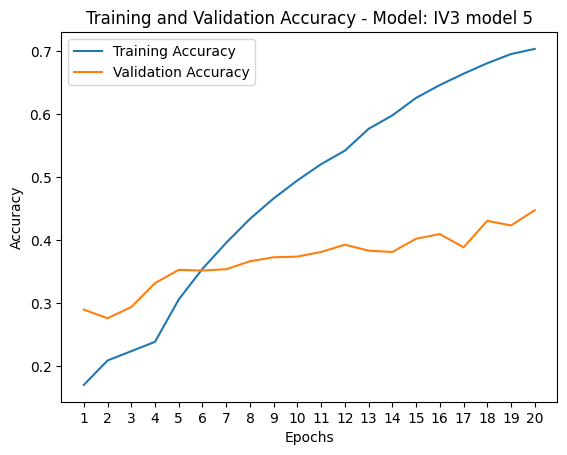

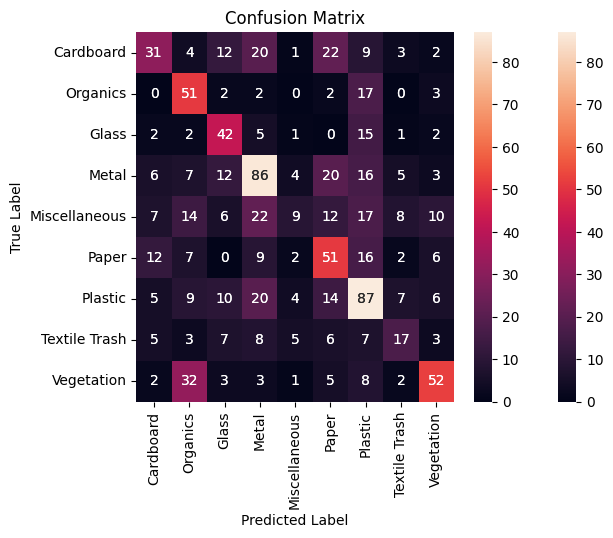

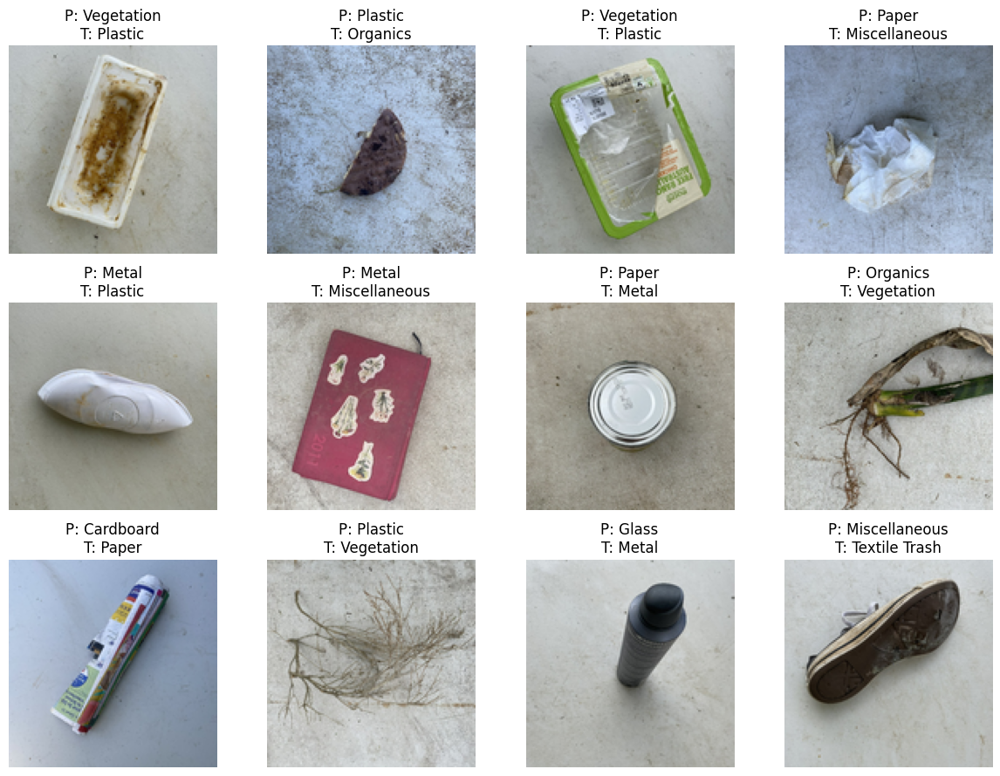

In [20]:
model_evaluation(IV3_5, (X_test_RGB, y_test_RGB), categories, r_categories, 12)

In [21]:
input_s = (131, 131, 3)
IV3 = InceptionV3(include_top = False, weights = "imagenet", input_shape = input_s)

IV3_model_6 = Sequential([IV3])

# keeping them untrainable, for now
for layer in IV3_model_6.layers:   # <====== MISSED THIS!!
    layer.trainable = False

# flatten, add final dense layers, add dropout layers, softmax layer
IV3_model_6.add(Flatten())    
IV3_model_6.add(Dense(512, activation='relu'))
IV3_model_6.add(Dense(1024, activation='relu'))
IV3_model_6.add(Dense(512, activation='relu'))
IV3_model_6.add(Dropout(0.2))
IV3_model_6.add(Dense(512, activation='relu'))
IV3_model_6.add(Dense(256, activation='relu'))
IV3_model_6.add(Dropout(0.2))
IV3_model_6.add(Dense(9, activation='softmax'))

#IV3_model_6.summary()

In [22]:
gc.collect()
tf.keras.backend.clear_session()
IV3_model_6.compile(optimizer = Adam(learning_rate=0.0000175), loss = "sparse_categorical_crossentropy", metrics = ["accuracy"])
IV3_6 = CNNModel(IV3_model_6, "IV3 model 6")
IV3_6.fit_model(train_data=(X_train_aug_RGB, y_train_aug_RGB), validation_data=(X_test_RGB, y_test_RGB), epochs=20, batch_size=16)

Epoch 1/20
476/476 [==============================] - 8s 12ms/step - loss: 4.8358 - accuracy: 0.1805 - val_loss: 2.4048 - val_accuracy: 0.2839
Epoch 2/20
476/476 [==============================] - 4s 9ms/step - loss: 2.4974 - accuracy: 0.2506 - val_loss: 2.0744 - val_accuracy: 0.2986
Epoch 3/20
476/476 [==============================] - 5s 11ms/step - loss: 2.0803 - accuracy: 0.3124 - val_loss: 1.9254 - val_accuracy: 0.3512
Epoch 4/20
476/476 [==============================] - 5s 10ms/step - loss: 1.8495 - accuracy: 0.3775 - val_loss: 1.8473 - val_accuracy: 0.3375
Epoch 5/20
476/476 [==============================] - 5s 12ms/step - loss: 1.7098 - accuracy: 0.4155 - val_loss: 1.8264 - val_accuracy: 0.3596
Epoch 6/20
476/476 [==============================] - 4s 9ms/step - loss: 1.5816 - accuracy: 0.4565 - val_loss: 1.7836 - val_accuracy: 0.3659
Epoch 7/20
476/476 [==============================] - 4s 9ms/step - loss: 1.4909 - accuracy: 0.4853 - val_loss: 1.8344 - val_accuracy: 0.3712
Ep

30/30 [==============================] - 1s 8ms/step
               precision    recall  f1-score   support

    Cardboard       0.50      0.36      0.42       104
     Organics       0.42      0.52      0.46        77
        Glass       0.48      0.60      0.54        70
        Metal       0.44      0.60      0.51       159
Miscellaneous       0.29      0.21      0.24       105
        Paper       0.48      0.30      0.36       105
      Plastic       0.40      0.52      0.45       162
Textile Trash       0.42      0.16      0.24        61
   Vegetation       0.59      0.56      0.58       108

     accuracy                           0.44       951
    macro avg       0.45      0.43      0.42       951
 weighted avg       0.44      0.44      0.43       951



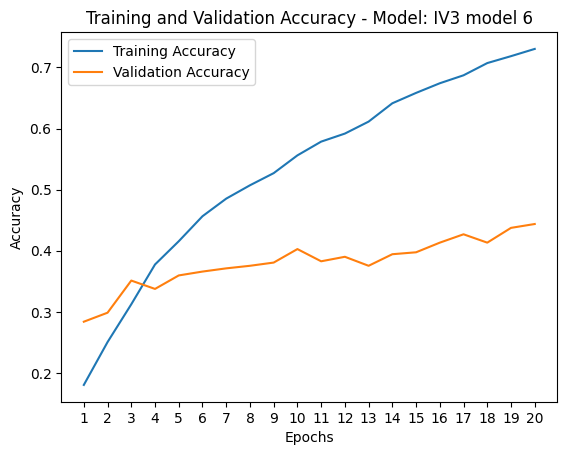

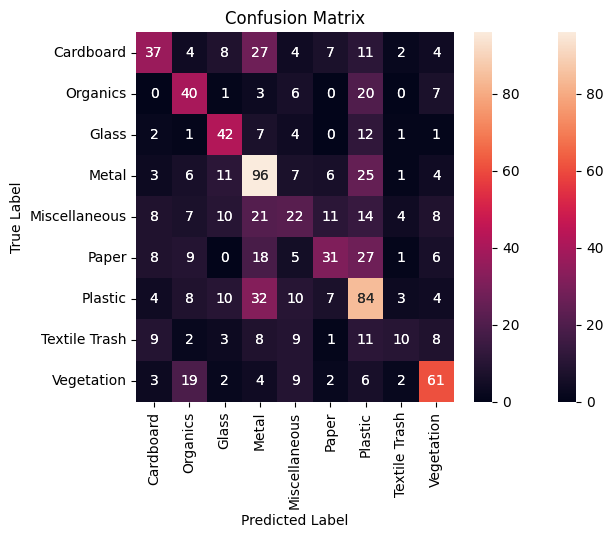

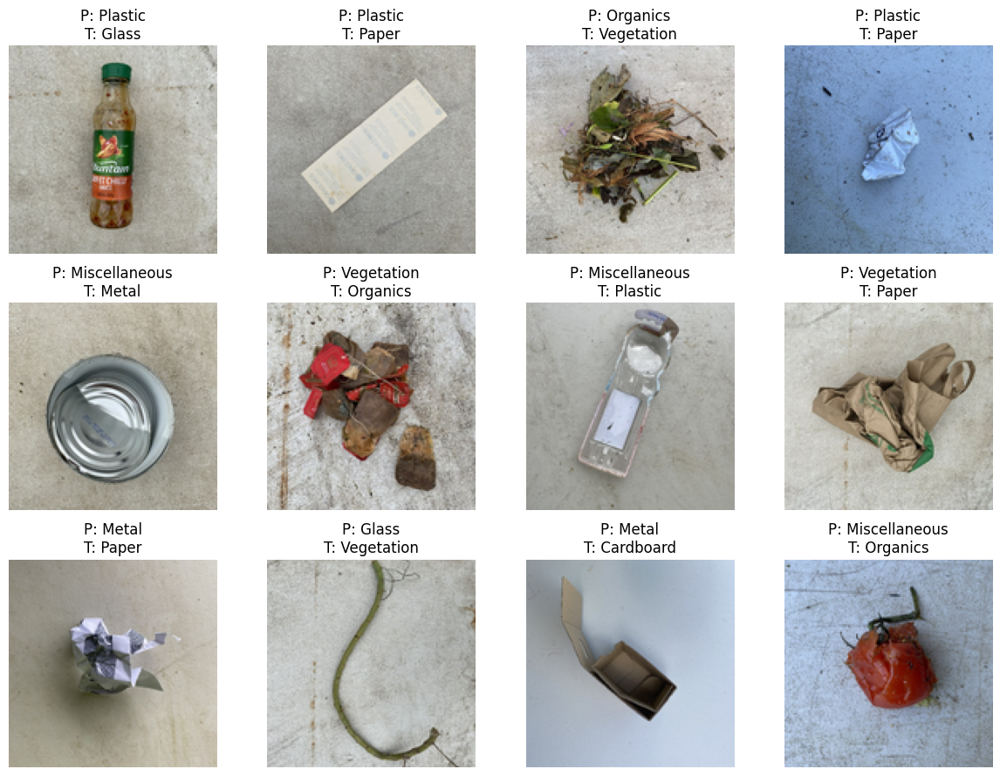

In [23]:
model_evaluation(IV3_6, (X_test_RGB, y_test_RGB), categories, r_categories, 12)

In [24]:
input_s = (131, 131, 3)
IV3 = InceptionV3(include_top = False, weights = "imagenet", input_shape = input_s)

IV3_model_7 = Sequential([IV3])

# keeping them untrainable, for now
for layer in IV3_model_7.layers:
    layer.trainable = False

# flatten, add final dense layers, add dropout layers, softmax layer
IV3_model_7.add(Flatten())    
IV3_model_7.add(Dense(512, activation='relu'))
IV3_model_7.add(Dense(256, activation='relu'))
IV3_model_7.add(Dense(512, activation='relu'))
IV3_model_7.add(Dense(256, activation='relu'))
IV3_model_7.add(Dropout(0.2))
IV3_model_7.add(Dense(512, activation='relu'))
IV3_model_7.add(Dense(256, activation='relu'))
IV3_model_7.add(Dropout(0.2))
IV3_model_7.add(Dense(512, activation='relu'))
IV3_model_7.add(Dense(256, activation='relu'))
IV3_model_7.add(Dense(9, activation='softmax'))

#IV3_model_7.summary()

In [25]:
gc.collect()
tf.keras.backend.clear_session()
IV3_model_7.compile(optimizer = Adam(learning_rate=0.0000175), loss = "sparse_categorical_crossentropy", metrics = ["accuracy"])
IV3_7 = CNNModel(IV3_model_7, "IV3 model 7")
IV3_7.fit_model(train_data=(X_train_aug_RGB, y_train_aug_RGB), validation_data=(X_test_RGB, y_test_RGB), epochs=20, batch_size=16)

Epoch 1/20
476/476 [==============================] - 9s 14ms/step - loss: 2.4692 - accuracy: 0.1723 - val_loss: 2.0289 - val_accuracy: 0.2566
Epoch 2/20
476/476 [==============================] - 5s 10ms/step - loss: 2.1401 - accuracy: 0.2189 - val_loss: 1.9161 - val_accuracy: 0.3291
Epoch 3/20
476/476 [==============================] - 5s 10ms/step - loss: 2.0455 - accuracy: 0.2449 - val_loss: 1.9823 - val_accuracy: 0.2934
Epoch 4/20
476/476 [==============================] - 5s 10ms/step - loss: 1.9593 - accuracy: 0.2901 - val_loss: 1.8860 - val_accuracy: 0.3375
Epoch 5/20
476/476 [==============================] - 5s 11ms/step - loss: 1.8304 - accuracy: 0.3456 - val_loss: 1.8707 - val_accuracy: 0.3302
Epoch 6/20
476/476 [==============================] - 5s 10ms/step - loss: 1.7076 - accuracy: 0.3875 - val_loss: 1.8434 - val_accuracy: 0.3607
Epoch 7/20
476/476 [==============================] - 5s 10ms/step - loss: 1.6138 - accuracy: 0.4225 - val_loss: 1.8003 - val_accuracy: 0.3565

30/30 [==============================] - 1s 7ms/step
               precision    recall  f1-score   support

    Cardboard       0.46      0.28      0.35       104
     Organics       0.44      0.55      0.49        77
        Glass       0.41      0.57      0.48        70
        Metal       0.48      0.49      0.49       159
Miscellaneous       0.24      0.08      0.12       105
        Paper       0.44      0.36      0.40       105
      Plastic       0.35      0.62      0.45       162
Textile Trash       0.42      0.21      0.28        61
   Vegetation       0.57      0.50      0.53       108

     accuracy                           0.42       951
    macro avg       0.42      0.41      0.40       951
 weighted avg       0.42      0.42      0.40       951



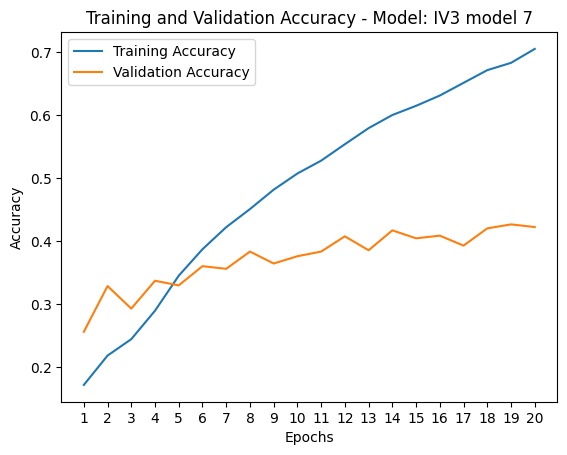

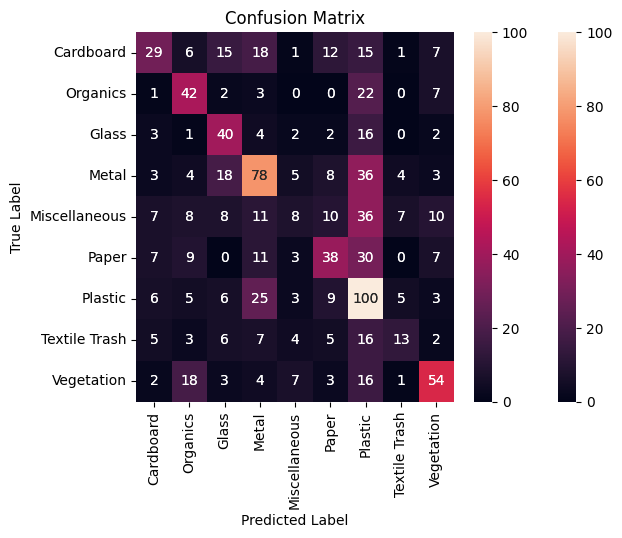

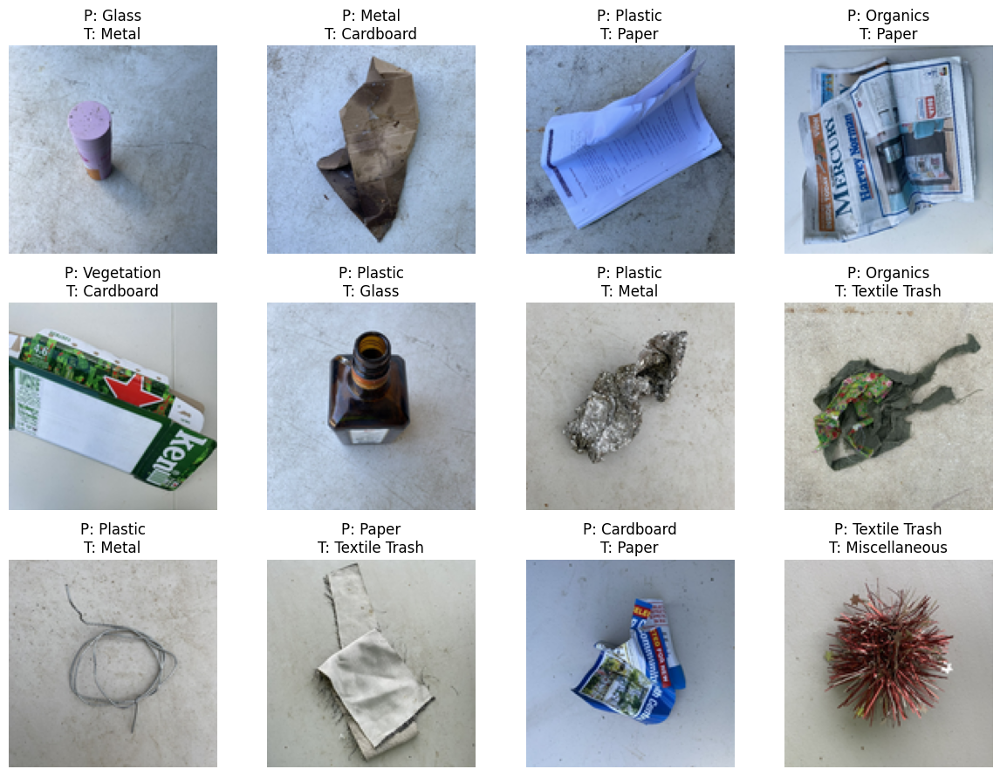

In [26]:
model_evaluation(IV3_7, (X_test_RGB, y_test_RGB), categories, r_categories, 12)

## ResNet50

In [27]:
input_t = Input(shape=(131, 131, 3))
RN50 = ResNet50(include_top=False, weights="imagenet", input_tensor=input_t)
RN_model_1 = Sequential([RN50])

for layer in RN_model_1.layers[:-1]:     # one example suggested leaving the last layer trainable, maybe try on IV3
    layer.trainable = False
    
RN_model_1.add(Flatten())    
RN_model_1.add(Dense(1024, activation='relu'))
RN_model_1.add(Dense(512, activation='relu'))
RN_model_1.add(Dropout(0.2))
RN_model_1.add(Dense(256, activation='relu'))
RN_model_1.add(Dense(9, activation='softmax'))

#RN_model_1.summary()

94765736/94765736 [==============================] - 80s 1us/step


In [28]:
gc.collect()
tf.keras.backend.clear_session()
RN_model_1.compile(optimizer = Adam(learning_rate=0.0000175), loss = "sparse_categorical_crossentropy", metrics = ["accuracy"])
RN_1 = CNNModel(RN_model_1, "ResNet50 model 1")
RN_1.fit_model(train_data=(X_train_aug_RGB, y_train_aug_RGB), validation_data=(X_test_RGB, y_test_RGB), epochs=20, batch_size=16)

Epoch 1/20
476/476 [==============================] - 38s 62ms/step - loss: 1.7467 - accuracy: 0.3745 - val_loss: 0.7164 - val_accuracy: 0.7434
Epoch 2/20
476/476 [==============================] - 28s 59ms/step - loss: 1.2865 - accuracy: 0.5350 - val_loss: 0.5671 - val_accuracy: 0.8097
Epoch 3/20
476/476 [==============================] - 30s 62ms/step - loss: 1.0815 - accuracy: 0.6084 - val_loss: 0.5588 - val_accuracy: 0.8223
Epoch 4/20
476/476 [==============================] - 29s 62ms/step - loss: 0.9358 - accuracy: 0.6571 - val_loss: 0.5365 - val_accuracy: 0.8360
Epoch 5/20
476/476 [==============================] - 29s 62ms/step - loss: 0.8481 - accuracy: 0.6986 - val_loss: 0.5683 - val_accuracy: 0.8212
Epoch 6/20
476/476 [==============================] - 29s 62ms/step - loss: 0.7897 - accuracy: 0.7140 - val_loss: 0.5720 - val_accuracy: 0.8360
Epoch 7/20
476/476 [==============================] - 29s 62ms/step - loss: 0.7231 - accuracy: 0.7373 - val_loss: 0.6633 - val_accuracy:

30/30 [==============================] - 1s 14ms/step
               precision    recall  f1-score   support

    Cardboard       0.94      0.75      0.83       104
     Organics       0.88      0.92      0.90        77
        Glass       0.88      0.91      0.90        70
        Metal       0.91      0.89      0.90       159
Miscellaneous       0.77      0.72      0.75       105
        Paper       0.82      0.86      0.84       105
      Plastic       0.85      0.86      0.86       162
Textile Trash       0.77      0.89      0.82        61
   Vegetation       0.91      0.98      0.94       108

     accuracy                           0.86       951
    macro avg       0.86      0.86      0.86       951
 weighted avg       0.86      0.86      0.86       951



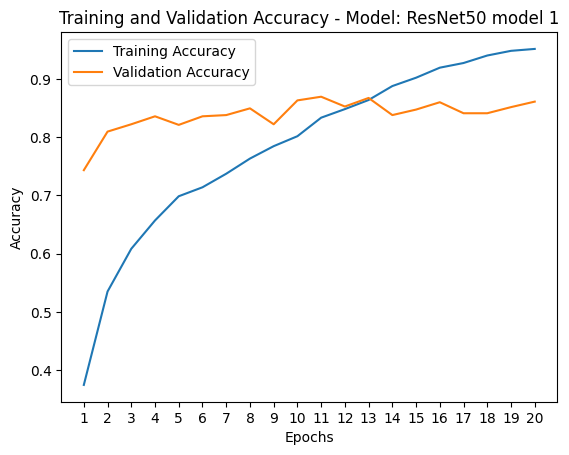

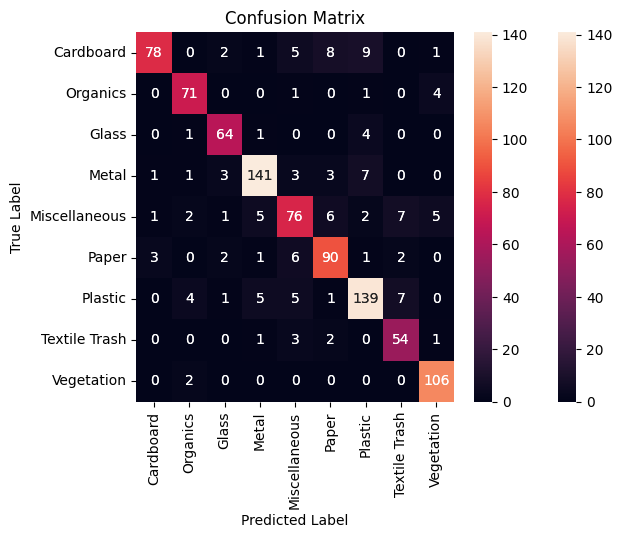

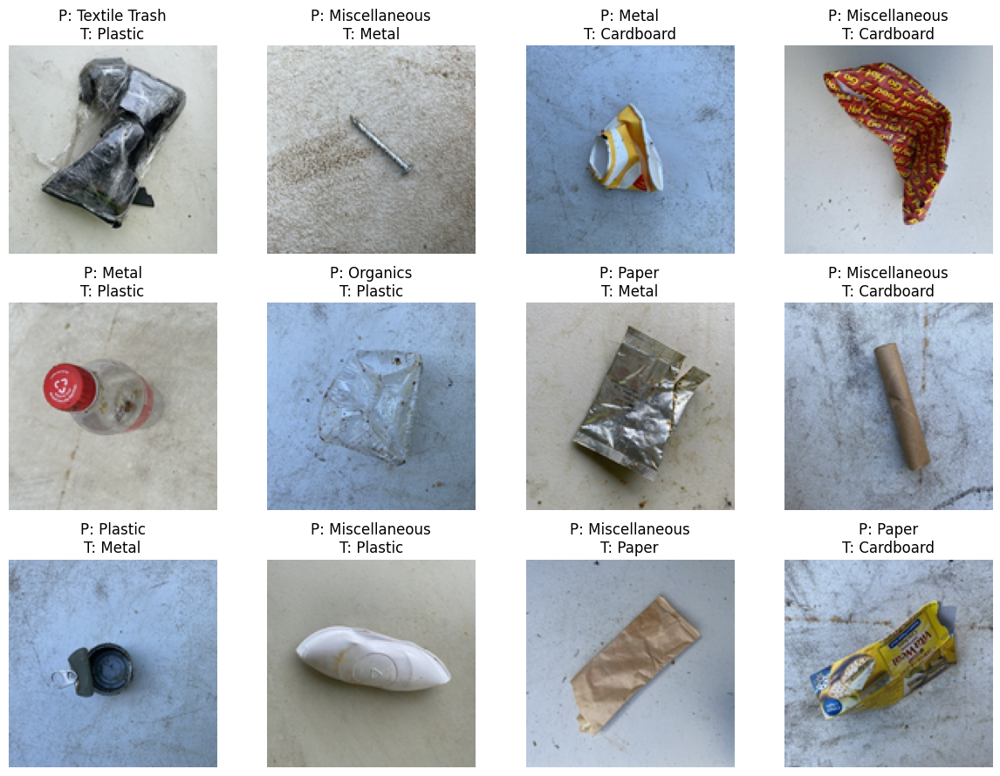

In [29]:
model_evaluation(RN_1, (X_test_RGB, y_test_RGB), categories, r_categories, 12)

This is interesting.  The accuracy of 0.65 is the best yet, and the confusion matrix shows that it has some skill in identifying each category.  However, the extreme volatility of the validation accuracy is concerning - it's bouncing all over the place.  I'd like to understand what this means.  Why it's happening, and what the implications could be for the reliability of such a model.

In [30]:
# RN50 is proving more productive than IV3

input_t = Input(shape=(131, 131, 3))
RN50 = ResNet50(include_top=False, weights="imagenet", input_tensor=input_t)
RN_model_2 = Sequential([RN50])

for layer in RN_model_2.layers:    
    layer.trainable = False
    
RN_model_2.add(Flatten())    
RN_model_2.add(Dense(1024, activation='relu'))
RN_model_2.add(Dense(512, activation='relu'))
RN_model_2.add(Dropout(0.2))
RN_model_2.add(Dense(512, activation='relu'))
RN_model_2.add(Dense(512, activation='relu'))
RN_model_2.add(Dropout(0.2))
RN_model_2.add(Dense(512, activation='relu'))
RN_model_2.add(Dense(512, activation='relu'))
RN_model_2.add(Dense(9, activation='softmax'))

#RN_model_2.summary()    

In [31]:
gc.collect()
tf.keras.backend.clear_session()
RN_model_2.compile(optimizer = Adam(learning_rate=0.0000175), loss = "sparse_categorical_crossentropy", metrics = ["accuracy"])
RN_2 = CNNModel(RN_model_2, "ResNet50 model 2")
RN_2.fit_model(train_data=(X_train_aug_RGB, y_train_aug_RGB), validation_data=(X_test_RGB, y_test_RGB), epochs=20, batch_size=16)

Epoch 1/20
476/476 [==============================] - 17s 31ms/step - loss: 1.8027 - accuracy: 0.3399 - val_loss: 0.8889 - val_accuracy: 0.6982
Epoch 2/20
476/476 [==============================] - 13s 27ms/step - loss: 1.4463 - accuracy: 0.4642 - val_loss: 0.7449 - val_accuracy: 0.7298
Epoch 3/20
476/476 [==============================] - 13s 28ms/step - loss: 1.2777 - accuracy: 0.5354 - val_loss: 0.6990 - val_accuracy: 0.7645
Epoch 4/20
476/476 [==============================] - 14s 29ms/step - loss: 1.1731 - accuracy: 0.5718 - val_loss: 0.6843 - val_accuracy: 0.7844
Epoch 5/20
476/476 [==============================] - 14s 29ms/step - loss: 1.1011 - accuracy: 0.6037 - val_loss: 0.6990 - val_accuracy: 0.7971
Epoch 6/20
476/476 [==============================] - 13s 28ms/step - loss: 1.0595 - accuracy: 0.6126 - val_loss: 0.8183 - val_accuracy: 0.7760
Epoch 7/20
476/476 [==============================] - 14s 29ms/step - loss: 1.0220 - accuracy: 0.6269 - val_loss: 0.7519 - val_accuracy:

30/30 [==============================] - 1s 13ms/step
               precision    recall  f1-score   support

    Cardboard       0.72      0.88      0.80       104
     Organics       0.84      0.88      0.86        77
        Glass       0.81      0.80      0.81        70
        Metal       0.75      0.89      0.82       159
Miscellaneous       0.83      0.62      0.71       105
        Paper       0.79      0.77      0.78       105
      Plastic       0.84      0.71      0.77       162
Textile Trash       0.72      0.69      0.71        61
   Vegetation       0.92      0.94      0.93       108

     accuracy                           0.80       951
    macro avg       0.80      0.80      0.80       951
 weighted avg       0.81      0.80      0.80       951



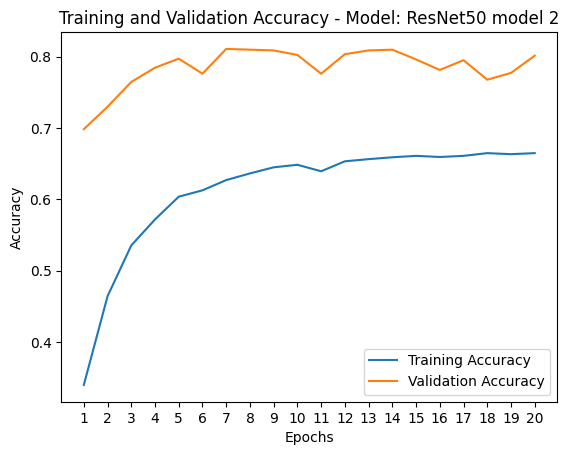

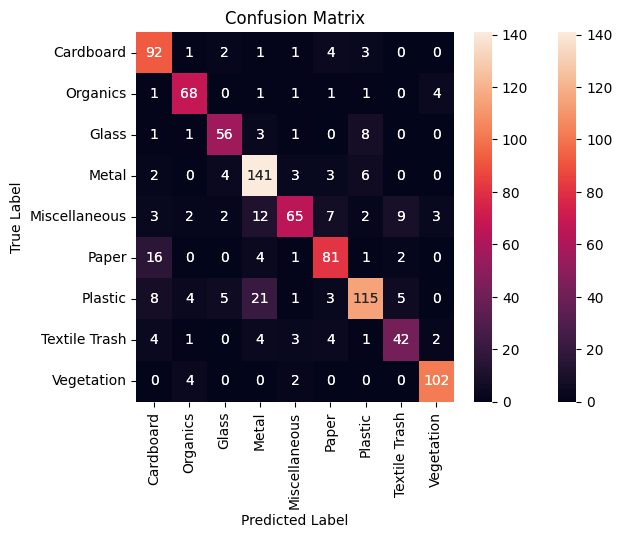

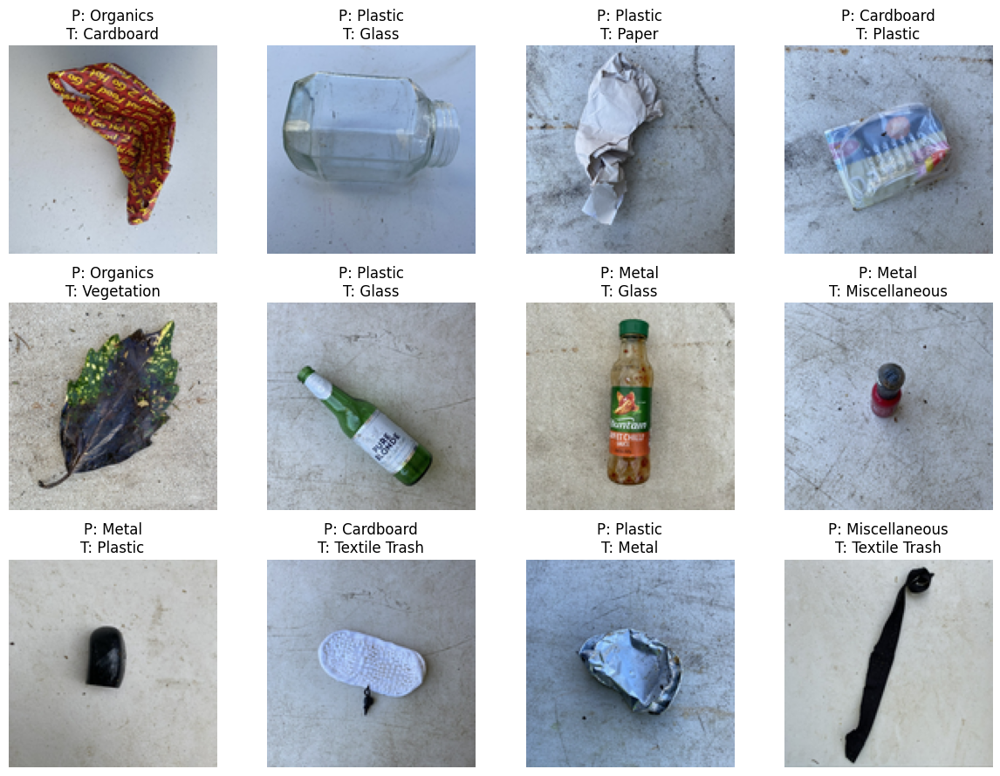

In [32]:
model_evaluation(RN_2, (X_test_RGB, y_test_RGB), categories, r_categories, 12)

## DenseNet-121

In [33]:
input_t = Input(shape=(131, 131, 3))
DN121 = DenseNet121(include_top=False, weights="imagenet", input_tensor=input_t)

DN_model_1 = Sequential([RN50])

for layer in DN_model_1.layers:     
    layer.trainable = False
    
DN_model_1.add(Flatten())    
DN_model_1.add(Dense(1024, activation='relu'))
DN_model_1.add(Dense(512, activation='relu'))
DN_model_1.add(Dense(1024, activation='relu'))
DN_model_1.add(Dropout(0.2))
DN_model_1.add(Dense(512, activation='relu'))
DN_model_1.add(Dense(9, activation='softmax'))

#DN_model_1.summary()  

29084464/29084464 [==============================] - 24s 1us/step


In [34]:
gc.collect()
tf.keras.backend.clear_session()
DN_model_1.compile(optimizer = Adam(learning_rate=0.0000175), loss = "sparse_categorical_crossentropy", metrics = ["accuracy"])
DN_1 = CNNModel(DN_model_1, "DenseNet-121 model 1")
DN_1.fit_model(train_data=(X_train_aug_RGB, y_train_aug_RGB), validation_data=(X_test_RGB, y_test_RGB), epochs=20, batch_size=16)

Epoch 1/20
476/476 [==============================] - 20s 38ms/step - loss: 1.6675 - accuracy: 0.3940 - val_loss: 0.8624 - val_accuracy: 0.6961
Epoch 2/20
476/476 [==============================] - 19s 40ms/step - loss: 1.2651 - accuracy: 0.5381 - val_loss: 0.6777 - val_accuracy: 0.7645
Epoch 3/20
476/476 [==============================] - 18s 38ms/step - loss: 1.1185 - accuracy: 0.5885 - val_loss: 0.6906 - val_accuracy: 0.7697
Epoch 4/20
476/476 [==============================] - 18s 39ms/step - loss: 1.0423 - accuracy: 0.6194 - val_loss: 0.7325 - val_accuracy: 0.7886
Epoch 5/20
476/476 [==============================] - 18s 37ms/step - loss: 1.0021 - accuracy: 0.6331 - val_loss: 0.7326 - val_accuracy: 0.7886
Epoch 6/20
476/476 [==============================] - 20s 42ms/step - loss: 0.9859 - accuracy: 0.6371 - val_loss: 0.7172 - val_accuracy: 0.7981
Epoch 7/20
476/476 [==============================] - 18s 37ms/step - loss: 0.9533 - accuracy: 0.6454 - val_loss: 0.7261 - val_accuracy:

30/30 [==============================] - 1s 13ms/step
               precision    recall  f1-score   support

    Cardboard       0.65      0.93      0.76       104
     Organics       0.92      0.84      0.88        77
        Glass       0.73      0.87      0.79        70
        Metal       0.73      0.88      0.80       159
Miscellaneous       0.74      0.70      0.72       105
        Paper       0.92      0.55      0.69       105
      Plastic       0.81      0.70      0.75       162
Textile Trash       0.80      0.57      0.67        61
   Vegetation       0.94      0.94      0.94       108

     accuracy                           0.78       951
    macro avg       0.80      0.78      0.78       951
 weighted avg       0.80      0.78      0.78       951



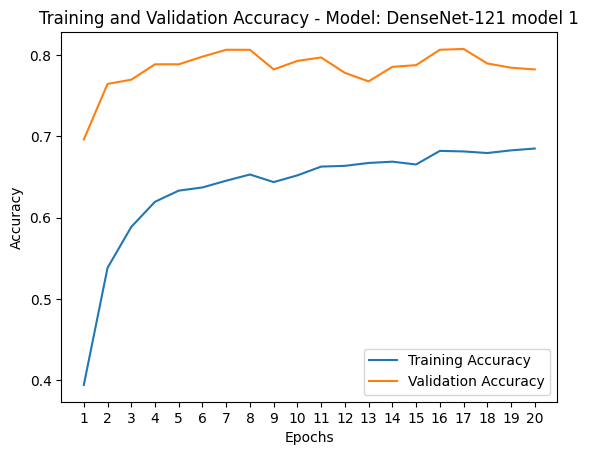

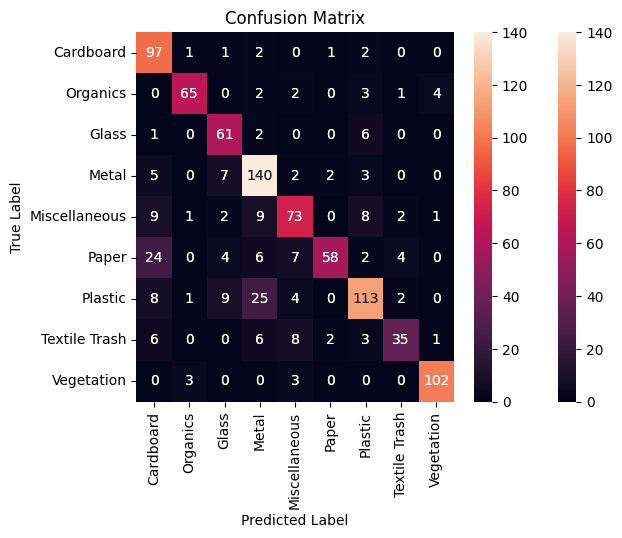

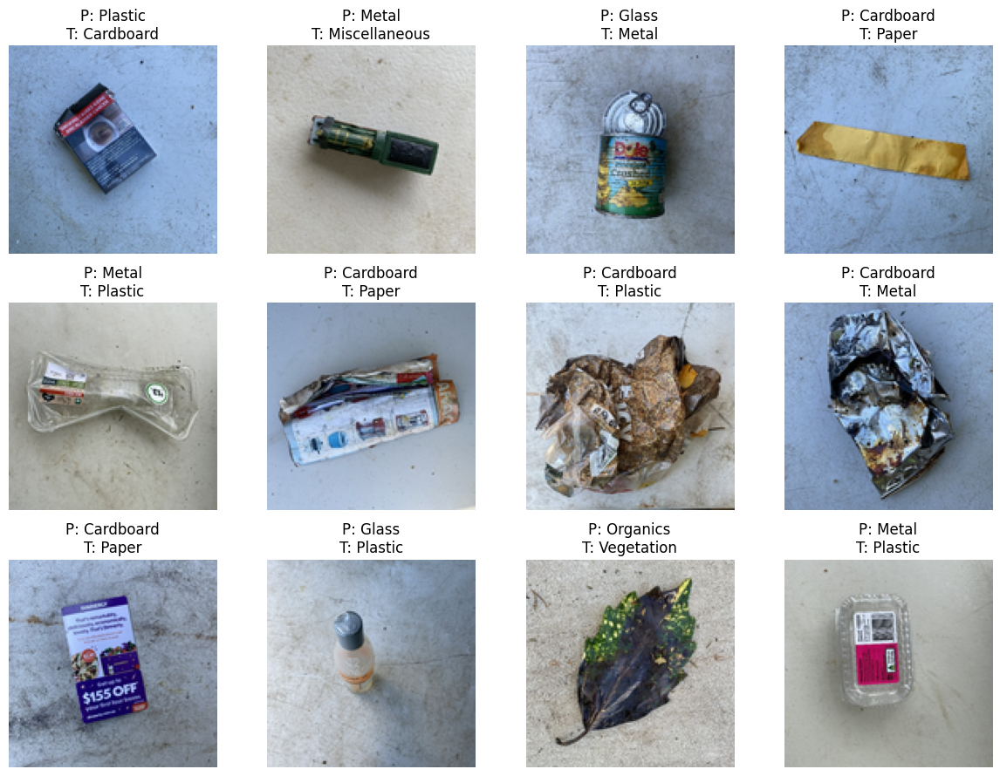

In [35]:
model_evaluation(DN_1, (X_test_RGB, y_test_RGB), categories, r_categories, 12)

In [36]:
input_t = Input(shape=(131, 131, 3))
DN121 = DenseNet121(include_top=False, weights="imagenet", input_tensor=input_t)

DN_model_2 = Sequential([RN50])

for layer in DN_model_2.layers:     
    layer.trainable = False
    
DN_model_2.add(Flatten())    
DN_model_2.add(Dense(512, activation='relu'))
DN_model_2.add(Dense(256, activation='relu'))
DN_model_2.add(Dense(512, activation='relu'))
DN_model_2.add(Dropout(0.2))
DN_model_2.add(Dense(256, activation='relu'))
DN_model_2.add(Dense(512, activation='relu'))
DN_model_2.add(Dropout(0.2))
DN_model_2.add(Dense(256, activation='relu'))
DN_model_2.add(Dense(9, activation='softmax'))

#DN_model_2.summary()

In [37]:
gc.collect()
tf.keras.backend.clear_session()
DN_model_2.compile(optimizer = Adam(learning_rate=0.0000175), loss = "sparse_categorical_crossentropy", metrics = ["accuracy"])
DN_2 = CNNModel(DN_model_2, "DenseNet-121 model 2")
DN_2.fit_model(train_data=(X_train_aug_RGB, y_train_aug_RGB), validation_data=(X_test_RGB, y_test_RGB), epochs=20, batch_size=16)

Epoch 1/20
476/476 [==============================] - 13s 24ms/step - loss: 1.8433 - accuracy: 0.3278 - val_loss: 0.9470 - val_accuracy: 0.6856
Epoch 2/20
476/476 [==============================] - 11s 22ms/step - loss: 1.4559 - accuracy: 0.4662 - val_loss: 0.7220 - val_accuracy: 0.7445
Epoch 3/20
476/476 [==============================] - 11s 22ms/step - loss: 1.2749 - accuracy: 0.5393 - val_loss: 0.7364 - val_accuracy: 0.7518
Epoch 4/20
476/476 [==============================] - 11s 22ms/step - loss: 1.1746 - accuracy: 0.5718 - val_loss: 0.6745 - val_accuracy: 0.7813
Epoch 5/20
476/476 [==============================] - 11s 22ms/step - loss: 1.0945 - accuracy: 0.6014 - val_loss: 0.6833 - val_accuracy: 0.7865
Epoch 6/20
476/476 [==============================] - 11s 22ms/step - loss: 1.0554 - accuracy: 0.6165 - val_loss: 0.7359 - val_accuracy: 0.7918
Epoch 7/20
476/476 [==============================] - 11s 22ms/step - loss: 1.0152 - accuracy: 0.6268 - val_loss: 0.7116 - val_accuracy:

30/30 [==============================] - 1s 12ms/step
               precision    recall  f1-score   support

    Cardboard       0.85      0.78      0.81       104
     Organics       0.86      0.88      0.87        77
        Glass       0.78      0.86      0.82        70
        Metal       0.80      0.86      0.83       159
Miscellaneous       0.74      0.67      0.70       105
        Paper       0.84      0.79      0.81       105
      Plastic       0.79      0.78      0.79       162
Textile Trash       0.68      0.74      0.71        61
   Vegetation       0.93      0.94      0.93       108

     accuracy                           0.81       951
    macro avg       0.81      0.81      0.81       951
 weighted avg       0.81      0.81      0.81       951



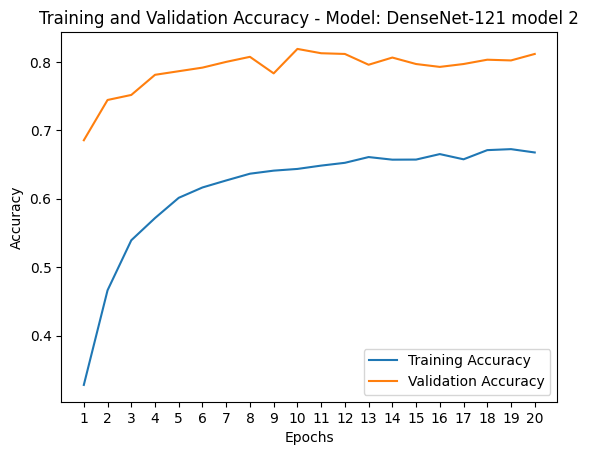

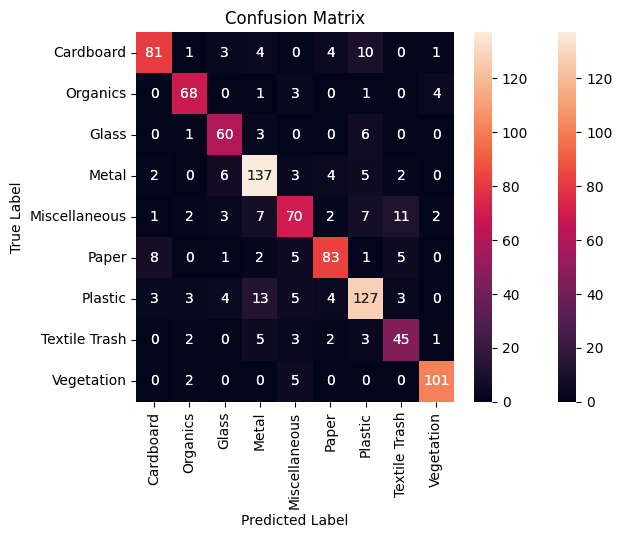

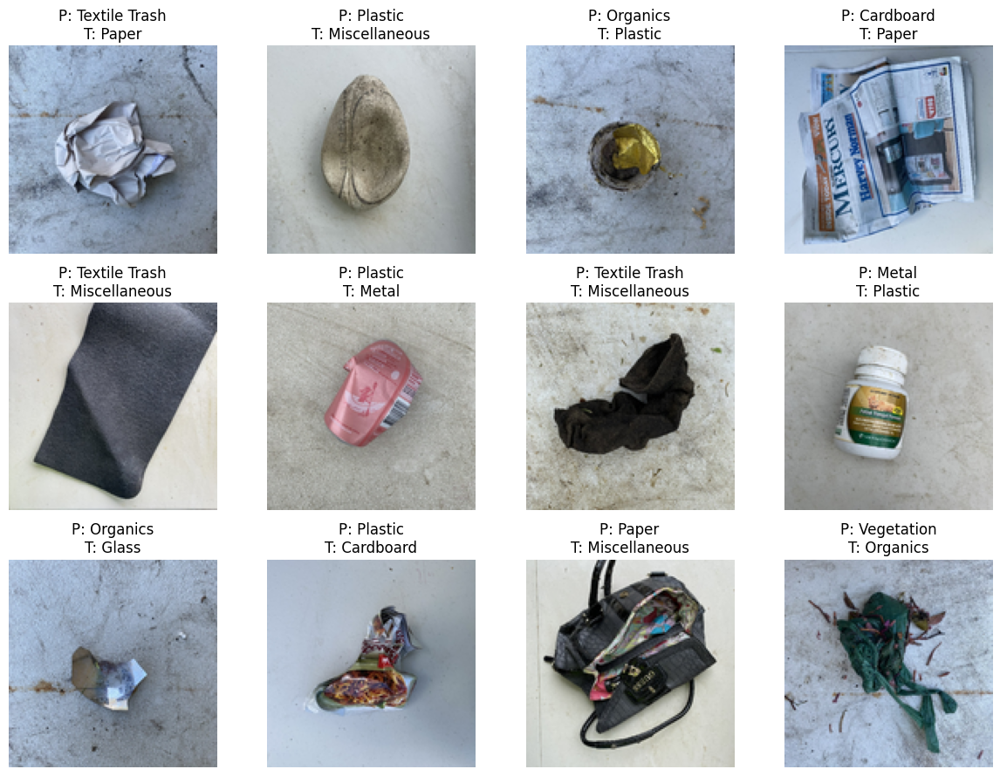

In [38]:
model_evaluation(DN_2, (X_test_RGB, y_test_RGB), categories, r_categories, 12)

# EfficientNet-B0

In [39]:
input_t = Input(shape=(131, 131, 3))
ENB0 = EfficientNetB0(include_top=False, weights="imagenet", input_tensor=input_t)

EN_model_1 = Sequential([ENB0])

for layer in EN_model_1.layers:     
    layer.trainable = False
    
EN_model_1.add(Flatten())    
EN_model_1.add(Dense(1024, activation='relu'))
EN_model_1.add(Dense(512, activation='relu'))
EN_model_1.add(Dense(1024, activation='relu'))
EN_model_1.add(Dropout(0.2))
EN_model_1.add(Dense(512, activation='relu'))
EN_model_1.add(Dense(9, activation='softmax'))

#EN_model_1.summary()

16705208/16705208 [==============================] - 13s 1us/step


In [40]:
gc.collect()
tf.keras.backend.clear_session()
EN_model_1.compile(optimizer = Adam(learning_rate=0.0000175), loss = "sparse_categorical_crossentropy", metrics = ["accuracy"])
EN_1 = CNNModel(EN_model_1, "EfficientNet-B0 model 1")
EN_1.fit_model(train_data=(X_train_aug_RGB, y_train_aug_RGB), validation_data=(X_test_RGB, y_test_RGB), epochs=20, batch_size=16)

Epoch 1/20
476/476 [==============================] - 16s 27ms/step - loss: 1.6444 - accuracy: 0.3977 - val_loss: 0.7115 - val_accuracy: 0.7413
Epoch 2/20
476/476 [==============================] - 12s 26ms/step - loss: 1.3049 - accuracy: 0.5184 - val_loss: 0.5169 - val_accuracy: 0.8212
Epoch 3/20
476/476 [==============================] - 12s 26ms/step - loss: 1.1887 - accuracy: 0.5626 - val_loss: 0.4959 - val_accuracy: 0.8265
Epoch 4/20
476/476 [==============================] - 12s 26ms/step - loss: 1.1374 - accuracy: 0.5788 - val_loss: 0.4272 - val_accuracy: 0.8570
Epoch 5/20
476/476 [==============================] - 12s 26ms/step - loss: 1.1139 - accuracy: 0.5876 - val_loss: 0.4174 - val_accuracy: 0.8665
Epoch 6/20
476/476 [==============================] - 12s 26ms/step - loss: 1.0951 - accuracy: 0.5916 - val_loss: 0.4131 - val_accuracy: 0.8791
Epoch 7/20
476/476 [==============================] - 12s 26ms/step - loss: 1.0919 - accuracy: 0.5922 - val_loss: 0.4992 - val_accuracy:

30/30 [==============================] - 1s 10ms/step
               precision    recall  f1-score   support

    Cardboard       0.93      0.79      0.85       104
     Organics       0.85      0.94      0.89        77
        Glass       0.94      0.90      0.92        70
        Metal       0.87      0.83      0.85       159
Miscellaneous       0.88      0.77      0.82       105
        Paper       0.83      0.91      0.87       105
      Plastic       0.82      0.93      0.87       162
Textile Trash       0.86      0.82      0.84        61
   Vegetation       0.95      0.98      0.97       108

     accuracy                           0.87       951
    macro avg       0.88      0.87      0.88       951
 weighted avg       0.88      0.87      0.87       951



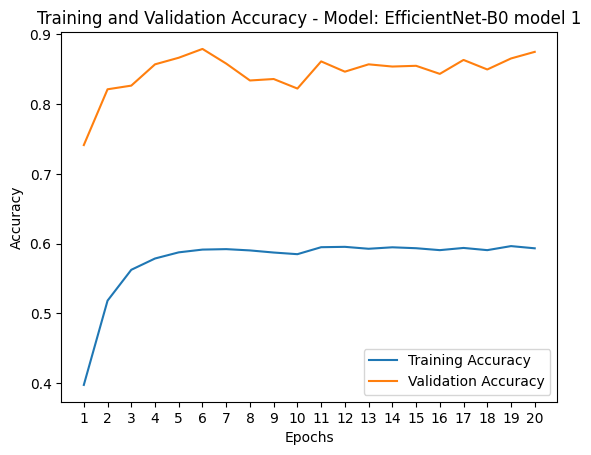

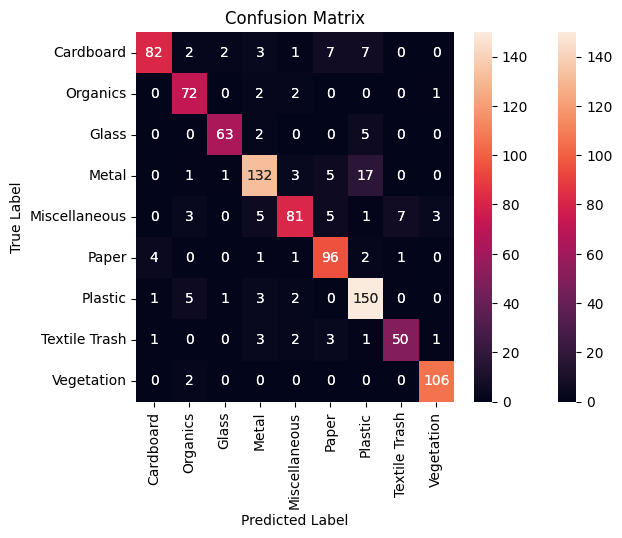

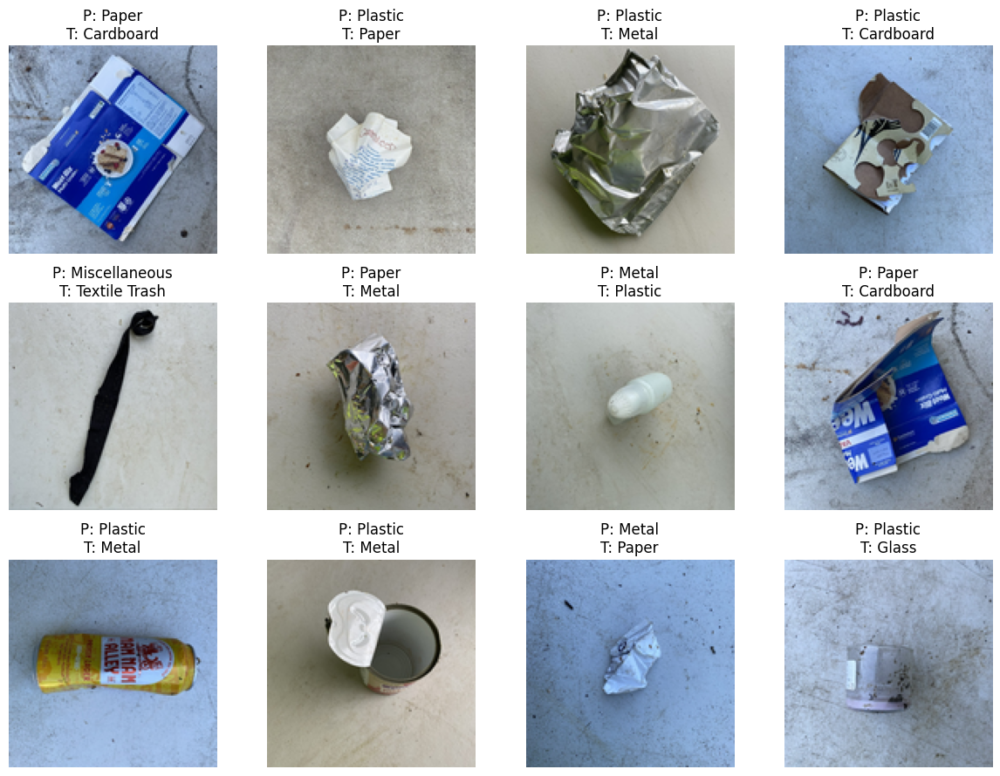

In [41]:
model_evaluation(EN_1, (X_test_RGB, y_test_RGB), categories, r_categories, 12)

In [42]:
input_t = Input(shape=(131, 131, 3))
ENB0 = EfficientNetB0(include_top=False, weights="imagenet", input_tensor=input_t)

EN_model_2 = Sequential([ENB0])

for layer in EN_model_2.layers:     
    layer.trainable = False
    
EN_model_2.add(Flatten())    
EN_model_2.add(Dense(512, activation='relu'))
EN_model_2.add(Dense(1024, activation='relu'))
EN_model_2.add(Dense(512, activation='relu'))
EN_model_2.add(Dropout(0.2))
EN_model_2.add(Dense(512, activation='relu'))
EN_model_2.add(Dense(256, activation='relu'))
EN_model_2.add(Dropout(0.2))
EN_model_2.add(Dense(256, activation='relu'))
EN_model_2.add(Dense(9, activation='softmax'))

#EN_model_2.summary()    

In [43]:
gc.collect()
tf.keras.backend.clear_session()
EN_model_2.compile(optimizer = Adam(learning_rate=0.0000175), loss = "sparse_categorical_crossentropy", metrics = ["accuracy"])
EN_2 = CNNModel(EN_model_2, "EfficientNet-B0 model 2")
EN_2.fit_model(train_data=(X_train_aug_RGB, y_train_aug_RGB), validation_data=(X_test_RGB, y_test_RGB), epochs=20, batch_size=4)

Epoch 1/20
1901/1901 [==============================] - 30s 14ms/step - loss: 1.7199 - accuracy: 0.3677 - val_loss: 0.7157 - val_accuracy: 0.7560
Epoch 2/20
1901/1901 [==============================] - 27s 14ms/step - loss: 1.3859 - accuracy: 0.4890 - val_loss: 0.5514 - val_accuracy: 0.8044
Epoch 3/20
1901/1901 [==============================] - 26s 14ms/step - loss: 1.2549 - accuracy: 0.5343 - val_loss: 0.4945 - val_accuracy: 0.8297
Epoch 4/20
1901/1901 [==============================] - 26s 14ms/step - loss: 1.1857 - accuracy: 0.5614 - val_loss: 0.4909 - val_accuracy: 0.8444
Epoch 5/20
1901/1901 [==============================] - 26s 14ms/step - loss: 1.1509 - accuracy: 0.5701 - val_loss: 0.5573 - val_accuracy: 0.8307
Epoch 6/20
1901/1901 [==============================] - 26s 14ms/step - loss: 1.1260 - accuracy: 0.5798 - val_loss: 0.4915 - val_accuracy: 0.8580
Epoch 7/20
1901/1901 [==============================] - 27s 14ms/step - loss: 1.1135 - accuracy: 0.5877 - val_loss: 0.6069 -

30/30 [==============================] - 1s 8ms/step
               precision    recall  f1-score   support

    Cardboard       0.92      0.84      0.87       104
     Organics       0.86      0.94      0.89        77
        Glass       0.97      0.84      0.90        70
        Metal       0.90      0.89      0.90       159
Miscellaneous       0.87      0.70      0.78       105
        Paper       0.79      0.92      0.85       105
      Plastic       0.84      0.88      0.86       162
Textile Trash       0.75      0.85      0.80        61
   Vegetation       0.98      0.95      0.97       108

     accuracy                           0.87       951
    macro avg       0.87      0.87      0.87       951
 weighted avg       0.88      0.87      0.87       951



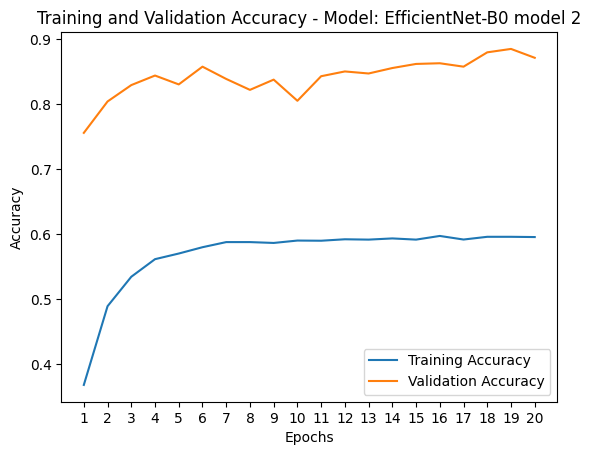

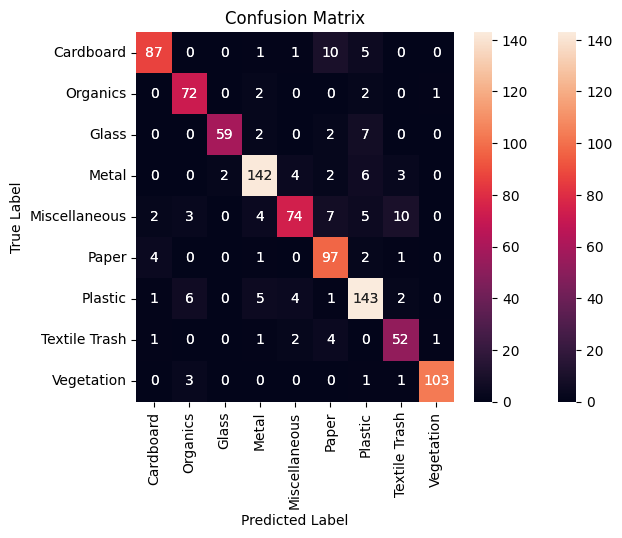

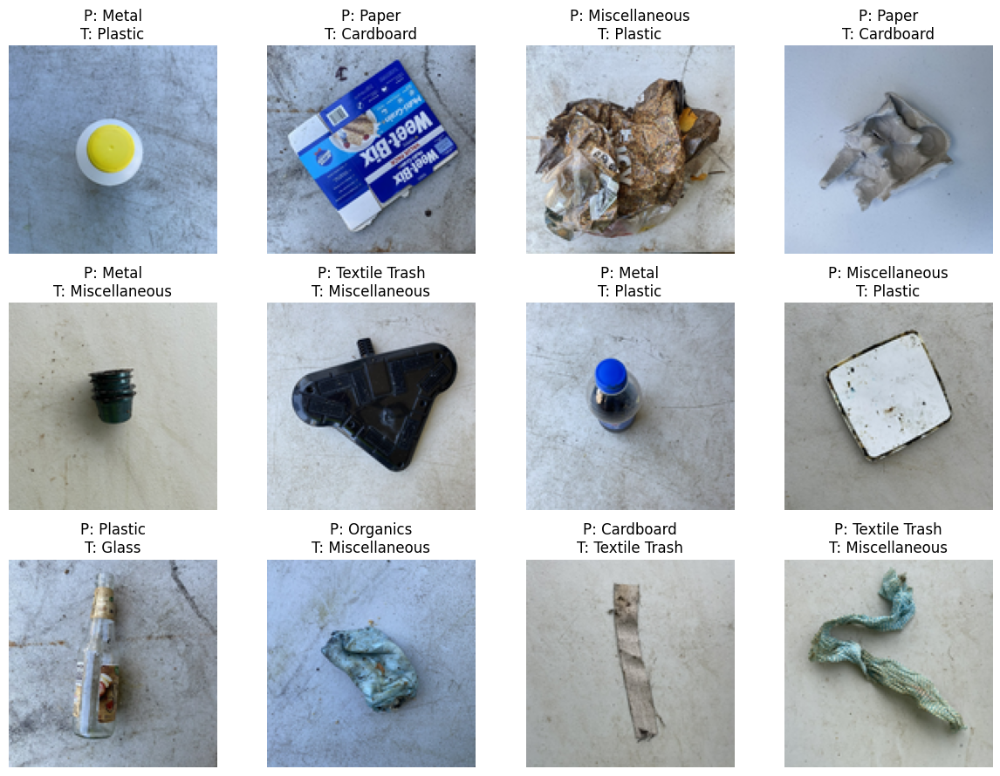

In [44]:
model_evaluation(EN_2, (X_test_RGB, y_test_RGB), categories, r_categories, 12)

 # VGG-16

In [45]:
input_t = Input(shape=(131, 131, 3))
VGG = VGG16(include_top=False, weights="imagenet", input_tensor=input_t)

VGG_model_1 = Sequential([VGG])

for layer in VGG_model_1.layers:     
    layer.trainable = False
    
VGG_model_1.add(Flatten())    
VGG_model_1.add(Dense(1024, activation='relu'))
VGG_model_1.add(Dense(512, activation='relu'))
VGG_model_1.add(Dense(256, activation='relu'))
VGG_model_1.add(Dropout(0.2))
VGG_model_1.add(Dense(256, activation='relu'))
VGG_model_1.add(Dense(9, activation='softmax'))

#VGG_model_1.summary()  

58889256/58889256 [==============================] - 43s 1us/step


In [46]:
gc.collect()
tf.keras.backend.clear_session()
VGG_model_1.compile(optimizer = Adam(learning_rate=0.0000175), loss = "sparse_categorical_crossentropy", metrics = ["accuracy"])
VGG_1 = CNNModel(VGG_model_1, "VGG-16 model 1")
VGG_1.fit_model(train_data=(X_train_aug_RGB, y_train_aug_RGB), validation_data=(X_test_RGB, y_test_RGB), epochs=20, batch_size=16)

Epoch 1/20
476/476 [==============================] - 9s 17ms/step - loss: 2.6785 - accuracy: 0.2843 - val_loss: 1.4698 - val_accuracy: 0.5668
Epoch 2/20
476/476 [==============================] - 8s 17ms/step - loss: 1.5309 - accuracy: 0.4772 - val_loss: 1.2100 - val_accuracy: 0.6467
Epoch 3/20
476/476 [==============================] - 8s 17ms/step - loss: 1.1741 - accuracy: 0.6013 - val_loss: 1.1724 - val_accuracy: 0.6793
Epoch 4/20
476/476 [==============================] - 8s 17ms/step - loss: 0.9667 - accuracy: 0.6713 - val_loss: 1.1215 - val_accuracy: 0.6961
Epoch 5/20
476/476 [==============================] - 8s 17ms/step - loss: 0.8498 - accuracy: 0.7060 - val_loss: 1.1502 - val_accuracy: 0.7035
Epoch 6/20
476/476 [==============================] - 8s 17ms/step - loss: 0.7510 - accuracy: 0.7427 - val_loss: 1.1415 - val_accuracy: 0.7171
Epoch 7/20
476/476 [==============================] - 8s 17ms/step - loss: 0.6841 - accuracy: 0.7682 - val_loss: 1.1357 - val_accuracy: 0.7224

30/30 [==============================] - 1s 18ms/step
               precision    recall  f1-score   support

    Cardboard       0.85      0.79      0.82       104
     Organics       0.78      0.86      0.81        77
        Glass       0.80      0.79      0.79        70
        Metal       0.75      0.75      0.75       159
Miscellaneous       0.73      0.54      0.62       105
        Paper       0.77      0.68      0.72       105
      Plastic       0.69      0.82      0.75       162
Textile Trash       0.58      0.62      0.60        61
   Vegetation       0.90      0.95      0.93       108

     accuracy                           0.76       951
    macro avg       0.76      0.76      0.76       951
 weighted avg       0.76      0.76      0.76       951



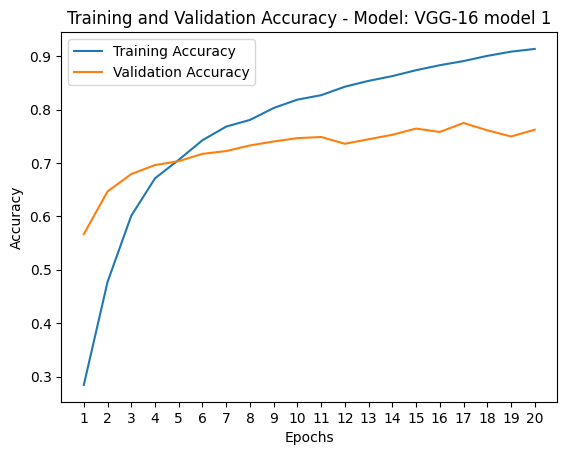

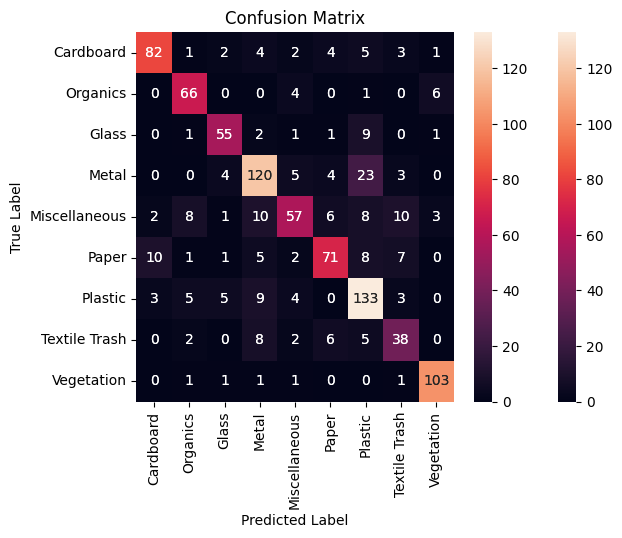

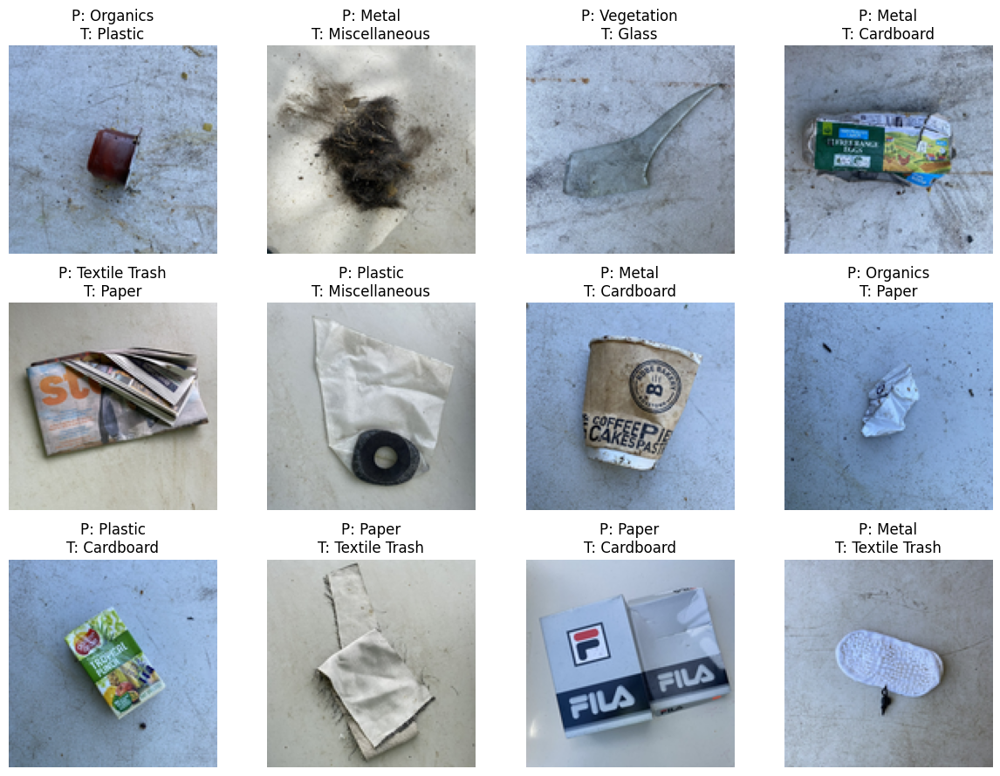

In [47]:
model_evaluation(VGG_1, (X_test_RGB, y_test_RGB), categories, r_categories, 12)

In [48]:
input_t = Input(shape=(131, 131, 3))
VGG = VGG16(include_top=False, weights="imagenet", input_tensor=input_t)

VGG_model_2 = Sequential([VGG])

for layer in VGG_model_2.layers:     
    layer.trainable = False
    
VGG_model_2.add(Flatten())    
VGG_model_2.add(Dense(512, activation='relu'))
VGG_model_2.add(Dense(1024, activation='relu'))
VGG_model_2.add(Dense(512, activation='relu'))
VGG_model_2.add(Dropout(0.2))
VGG_model_2.add(Dense(1024, activation='relu'))
VGG_model_2.add(Dense(512, activation='relu'))
VGG_model_2.add(Dropout(0.2))
VGG_model_2.add(Dense(256, activation='relu'))
VGG_model_2.add(Dense(9, activation='softmax'))

#VGG_model_2.summary()

In [50]:
gc.collect()
tf.keras.backend.clear_session()
VGG_model_2.compile(optimizer = Adam(learning_rate=0.0000175), loss = "sparse_categorical_crossentropy", metrics = ["accuracy"])
VGG_2 = CNNModel(VGG_model_2, "VGG-16 model 1")
VGG_2.fit_model(train_data=(X_train_aug_RGB, y_train_aug_RGB), validation_data=(X_test_RGB, y_test_RGB), epochs=20, batch_size=16)

Epoch 1/20
476/476 [==============================] - 8s 14ms/step - loss: 2.1935 - accuracy: 0.2432 - val_loss: 1.3467 - val_accuracy: 0.5710
Epoch 2/20
476/476 [==============================] - 7s 14ms/step - loss: 1.6759 - accuracy: 0.3869 - val_loss: 1.0576 - val_accuracy: 0.6498
Epoch 3/20
476/476 [==============================] - 7s 14ms/step - loss: 1.3985 - accuracy: 0.4957 - val_loss: 0.9075 - val_accuracy: 0.7035
Epoch 4/20
476/476 [==============================] - 7s 14ms/step - loss: 1.1832 - accuracy: 0.5860 - val_loss: 0.8195 - val_accuracy: 0.7350
Epoch 5/20
476/476 [==============================] - 7s 14ms/step - loss: 0.9980 - accuracy: 0.6419 - val_loss: 0.8423 - val_accuracy: 0.7476
Epoch 6/20
476/476 [==============================] - 7s 14ms/step - loss: 0.8642 - accuracy: 0.6915 - val_loss: 0.8491 - val_accuracy: 0.7624
Epoch 7/20
476/476 [==============================] - 7s 14ms/step - loss: 0.7551 - accuracy: 0.7295 - val_loss: 0.9400 - val_accuracy: 0.7697

30/30 [==============================] - 1s 18ms/step
               precision    recall  f1-score   support

    Cardboard       0.80      0.85      0.82       104
     Organics       0.81      0.91      0.86        77
        Glass       0.81      0.83      0.82        70
        Metal       0.77      0.80      0.78       159
Miscellaneous       0.67      0.59      0.63       105
        Paper       0.74      0.71      0.72       105
      Plastic       0.77      0.80      0.78       162
Textile Trash       0.77      0.66      0.71        61
   Vegetation       0.96      0.92      0.94       108

     accuracy                           0.79       951
    macro avg       0.79      0.78      0.78       951
 weighted avg       0.79      0.79      0.78       951



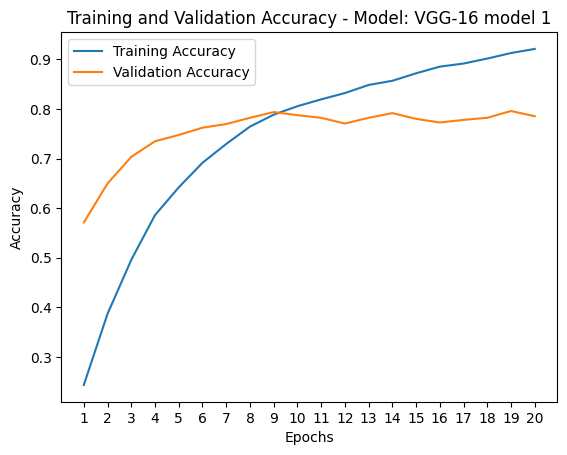

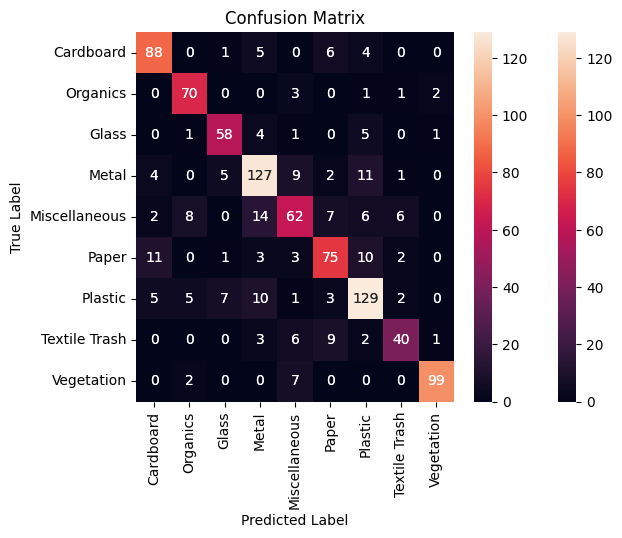

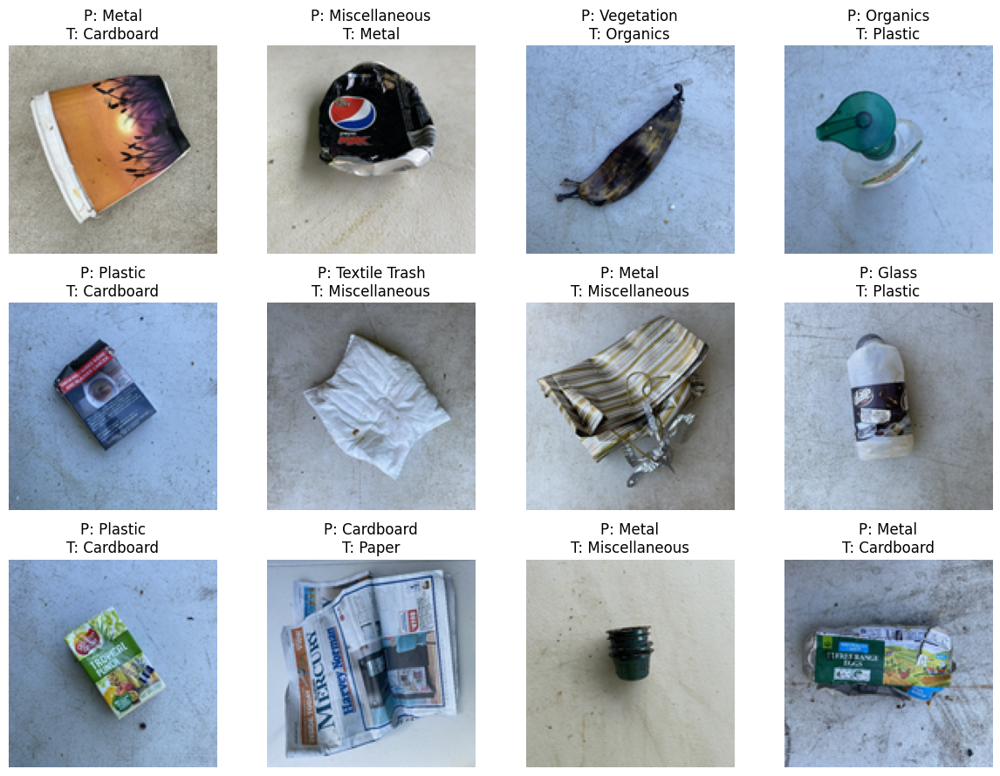

In [51]:
model_evaluation(VGG_2, (X_test_RGB, y_test_RGB), categories, r_categories, 12)

I think that's more than enough models for this first modeling notebook.  I'm going to step back, assess and document all these results, and then consider some subsequent work: a notebook to model the variability we have in model fitting.  And perhaps I'd like to see if we can apply CNN's in a hierarchial manner - that is, maybe a first CNN to differentiate among vegetation-organics, paper-cardboard, and glass-plastic-metal (for example) and then a second one to classify further?  There's a lot of fertile ground here.